<a href="https://colab.research.google.com/github/Ketan-Kapse/PneumoniaTypeClassifier/blob/main/BACTERIAL.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

PRE-REQUISITES

In [ ]:
from google.colab import drive
drive.mount('/content/drive')          #

Mounted at /content/drive


In [ ]:
%cd /content/drive/My\ Drive/Bacterial_pneumonia


/content/drive/My Drive/Bacterial_pneumonia


IMPORTING LIBRARIES

In [ ]:
import tensorflow as tf                                             
import numpy as np                                                  
import argparse
import cv2
import os                                                
import matplotlib.pyplot as plt

from PIL import Image
from glob import glob
from tensorflow.keras.preprocessing import image_dataset_from_directory
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.layers import AveragePooling2D, Dropout,Flatten, Dense
from tensorflow.keras.applications.resnet import ResNet50
from tensorflow.keras.applications.resnet import preprocess_input
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ReduceLROnPlateau


PRE-PROCESSING

In [ ]:
image_size = [224, 224]

train = 'train'
valid = 'test'

In [ ]:
res = tf.keras.applications.ResNet50V2(
    input_shape=image_size + [3],
    weights='imagenet', #0-1
    include_top=False)

94674944/94668760 [==============================] - 2s 0us/step


In [ ]:
folders = glob('train/*')
len(folders)

2

CUSTOM LAYERS

In [ ]:
pooling=AveragePooling2D(pool_size=(4,4))(res.output)   
flat = Flatten()(pooling)
dense1=Dense(32, activation='relu')(flat)
dense2=Dense(16, activation='relu')(dense1)
dropout2=Dropout(0.5)(dense2)
dense2=Dense(2,activation='softmax')(dropout2)

model=Model(inputs=res.input,outputs=dense2)

In [ ]:
for layer in res.layers:
    layer.trainable = False

In [ ]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 230, 230, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
conv1_conv (Conv2D)             (None, 112, 112, 64) 9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
pool1_pad (ZeroPadding2D)       (None, 114, 114, 64) 0           conv1_conv[0][0]                 
______________________________________________________________________________________________

In [ ]:
len(model.layers)

196

COMPILATION AND DATA AUGMENTATION


In [ ]:
model.compile(
  loss='categorical_crossentropy',
  optimizer=Adam(learning_rate=0.001),
  metrics=['accuracy']
)

In [ ]:
train_datagen = ImageDataGenerator(rescale = 1./255,
                                   shear_range = 0.05,
                                   zoom_range = 0.05,
                                   width_shift_range=0.1,
                                   height_shift_range=0.1,
                                   horizontal_flip = True,
                                   rotation_range=15,
                                   fill_mode="nearest")

test_datagen = ImageDataGenerator(rescale = 1./255)

In [ ]:

training_set = train_datagen.flow_from_directory(train,
                                                 target_size = (224, 224),
                                                 batch_size = 32,
                                                 class_mode='categorical')
training_set.class_indices


Found 2000 images belonging to 2 classes.


{'BACTERIA': 0, 'NORMAL': 1}

In [ ]:
test_set = test_datagen.flow_from_directory(valid,
                                            target_size = (224, 224),
                                            batch_size = 32,
                                            class_mode='categorical')
test_set.class_indices

Found 762 images belonging to 2 classes.


{'BACTERIA': 0, 'NORMAL': 1}

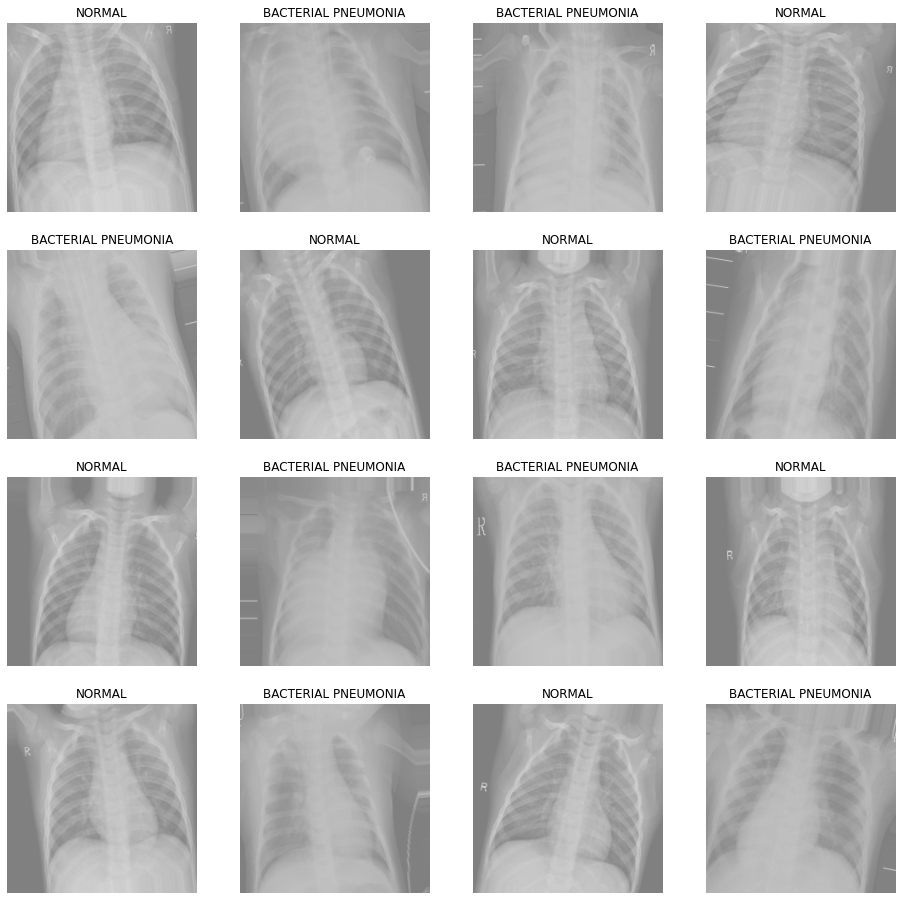

In [ ]:
all_labels = ['BACTERIAL PNEUMONIA','NORMAL']
t_x, t_y = next(training_set)
fig, m_axs = plt.subplots(4, 4, figsize = (16, 16))
for (c_x, c_y, c_ax) in zip(t_x, t_y, m_axs.flatten()):
    c_ax.imshow(c_x[:,:,0], cmap= 'gray', vmin = -1.5, vmax = 1.5)
    c_ax.set_title(', '.join([n_class for n_class, n_score in zip(all_labels, c_y) 
                             if n_score>0.5]))
    c_ax.axis('off')

TRAINING

In [ ]:
reduce_lr = ReduceLROnPlateau(monitor='accuracy', factor=0.2,
                              patience=5, verbose=1, cooldown=3, mode='auto', min_delta=0.01)

In [ ]:
history = model.fit(
  training_set,
  validation_data=test_set,
  epochs=15,
  steps_per_epoch=63,     # len(train)//batchsize
  validation_steps=24,
  callbacks=[reduce_lr]
  
)

Epoch 1/15
63/63 [==============================] - 1377s 22s/step - loss: 0.4784 - accuracy: 0.7565 - val_loss: 0.2153 - val_accuracy: 0.9383
Epoch 2/15
63/63 [==============================] - 58s 923ms/step - loss: 0.2971 - accuracy: 0.8860 - val_loss: 0.2330 - val_accuracy: 0.9265
Epoch 3/15
63/63 [==============================] - 57s 908ms/step - loss: 0.2451 - accuracy: 0.9125 - val_loss: 0.1633 - val_accuracy: 0.9370
Epoch 4/15
63/63 [==============================] - 58s 917ms/step - loss: 0.2118 - accuracy: 0.9195 - val_loss: 0.2063 - val_accuracy: 0.9318
Epoch 5/15
63/63 [==============================] - 58s 918ms/step - loss: 0.2061 - accuracy: 0.9230 - val_loss: 0.1792 - val_accuracy: 0.9318
Epoch 6/15
63/63 [==============================] - 57s 911ms/step - loss: 0.2115 - accuracy: 0.9150 - val_loss: 0.1678 - val_accuracy: 0.9344
Epoch 7/15
63/63 [==============================] - 58s 913ms/step - loss: 0.1771 - accuracy: 0.9370 - val_loss: 0.2127 - val_accuracy: 0.9331

VISUALIZATION

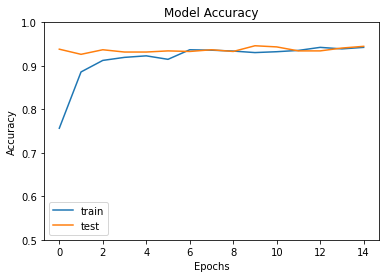

In [ ]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epochs')
plt.legend(['train', 'test'])
plt.ylim([0.5,1])
plt.show()

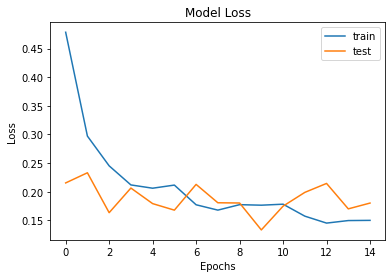

In [ ]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epochs')
plt.legend(['train', 'test'])
#plt.ylim(0.0,)
plt.show()

In [ ]:
model.save('saved_model/trained1.h5', save_format='h5')

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


PREDICTIONS

10/10 [==============================] - 62s 492ms/step
Predictions finished
prob:[0.9543179  0.04568207]
BACTERIA/person582_bacteria_2404.jpeg


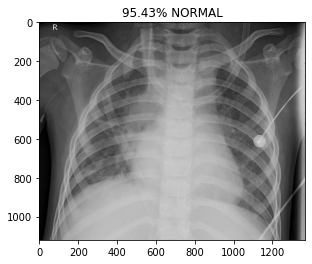

prob:[0.93995464 0.06004542]
BACTERIA/person582_bacteria_2405.jpeg


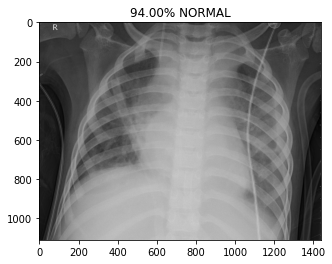

prob:[0.0766783  0.92332166]
BACTERIA/person583_bacteria_2406.jpeg


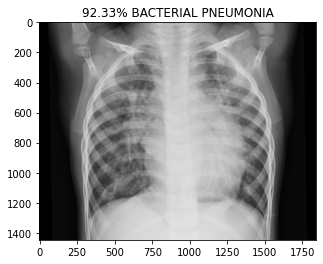

prob:[0.07709812 0.9229019 ]
BACTERIA/person583_bacteria_2408.jpeg


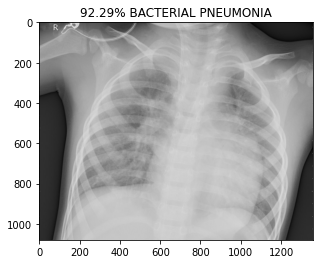

prob:[0.11154564 0.8884543 ]
BACTERIA/person583_bacteria_2409.jpeg


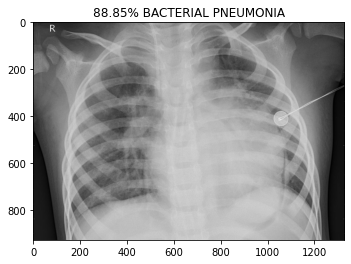

prob:[0.05465438 0.9453456 ]
BACTERIA/person585_bacteria_2411.jpeg


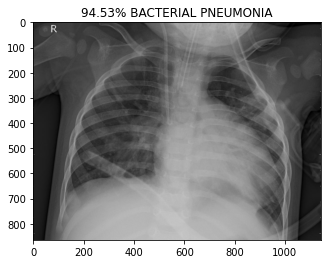

prob:[0.96236265 0.03763736]
BACTERIA/person585_bacteria_2412.jpeg


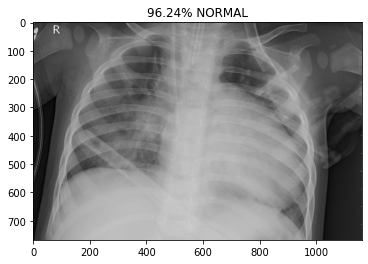

prob:[0.98870826 0.01129179]
BACTERIA/person585_bacteria_2413.jpeg


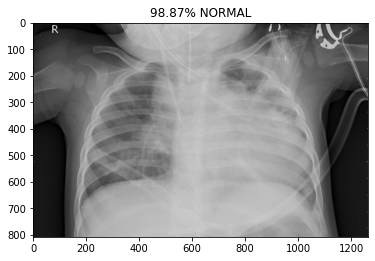

prob:[0.01838181 0.9816182 ]
BACTERIA/person585_bacteria_2414.jpeg


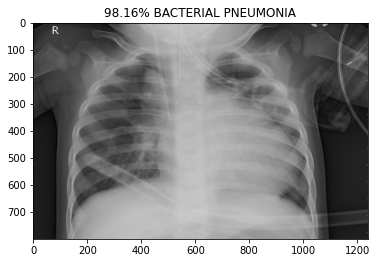

prob:[0.11207621 0.88792384]
BACTERIA/person585_bacteria_2415.jpeg


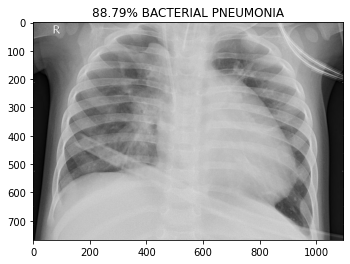

prob:[0.37216187 0.62783813]
BACTERIA/person585_bacteria_2416.jpeg


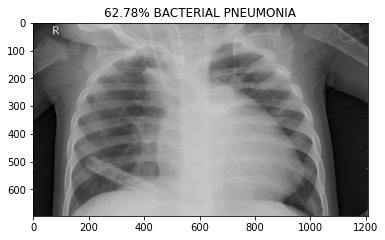

prob:[0.6923719  0.30762804]
BACTERIA/person586_bacteria_2417.jpeg


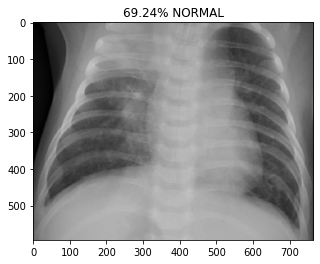

prob:[0.19487242 0.80512756]
BACTERIA/person586_bacteria_2418.jpeg


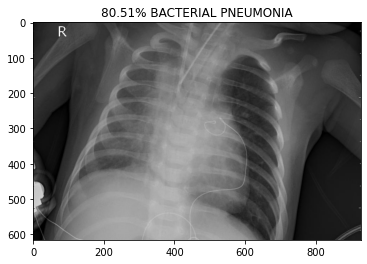

prob:[0.12965924 0.87034076]
BACTERIA/person586_bacteria_2420.jpeg


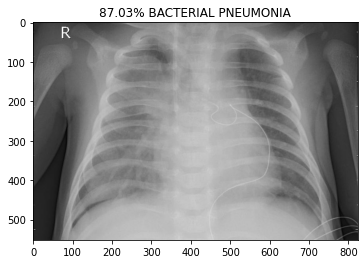

prob:[0.1572654 0.8427346]
BACTERIA/person587_bacteria_2421.jpeg


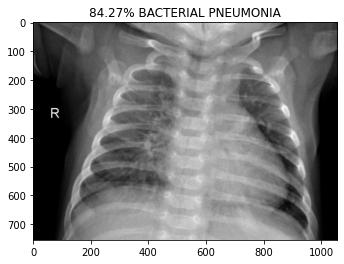

prob:[0.8388614  0.16113862]
BACTERIA/person588_bacteria_2422.jpeg


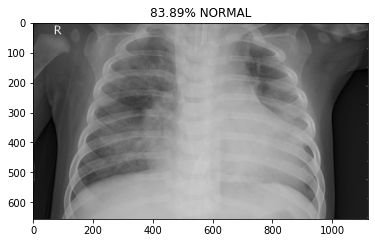

prob:[0.6455687 0.3544313]
BACTERIA/person588_bacteria_2423.jpeg


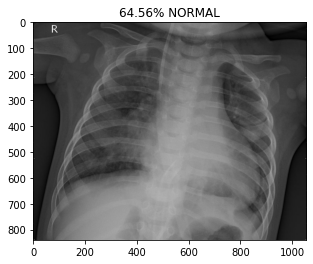

prob:[0.5479126  0.45208737]
BACTERIA/person589_bacteria_2424.jpeg


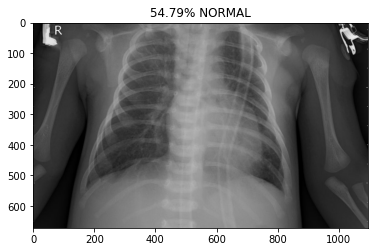

prob:[0.9737762  0.02622381]
BACTERIA/person589_bacteria_2425.jpeg


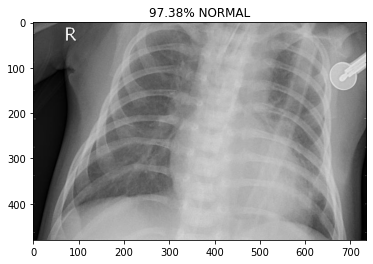

prob:[0.49878663 0.5012133 ]
BACTERIA/person590_bacteria_2428.jpeg


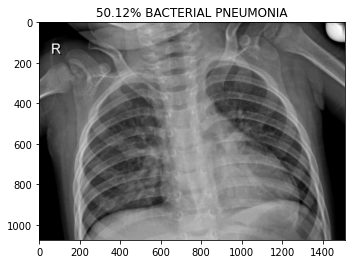

prob:[0.9854278  0.01457222]
BACTERIA/person591_bacteria_2429.jpeg


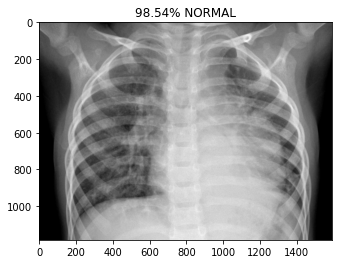

prob:[0.8927639  0.10723609]
BACTERIA/person592_bacteria_2431.jpeg


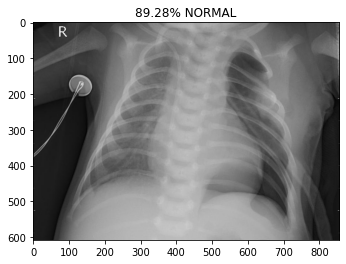

prob:[0.11523105 0.88476896]
BACTERIA/person592_bacteria_2434.jpeg


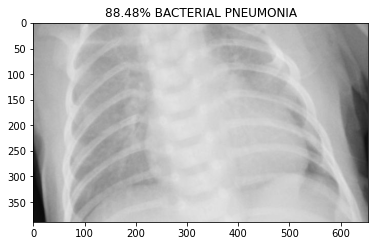

prob:[0.97902894 0.02097108]
BACTERIA/person593_bacteria_2435.jpeg


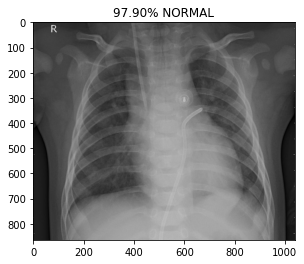

prob:[0.16701108 0.8329889 ]
BACTERIA/person594_bacteria_2436.jpeg


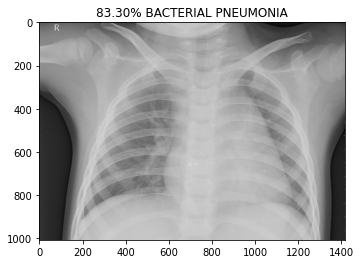

prob:[0.1639789  0.83602107]
BACTERIA/person595_bacteria_2438.jpeg


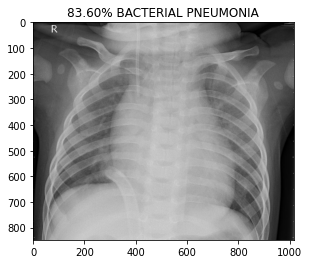

prob:[0.10821895 0.89178103]
BACTERIA/person596_bacteria_2440.jpeg


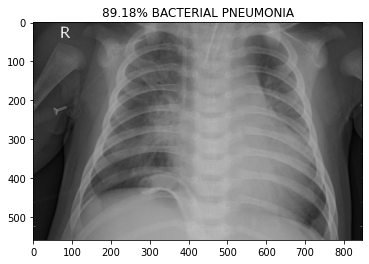

prob:[0.09192596 0.908074  ]
BACTERIA/person596_bacteria_2441.jpeg


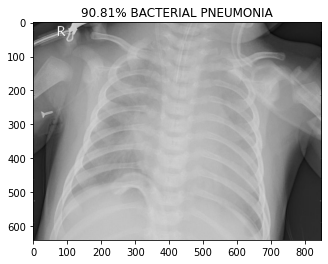

prob:[0.95211995 0.04788007]
BACTERIA/person596_bacteria_2443.jpeg


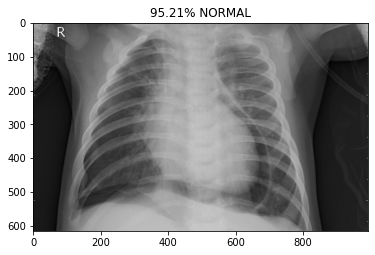

prob:[0.12525389 0.87474614]
BACTERIA/person596_bacteria_2444.jpeg


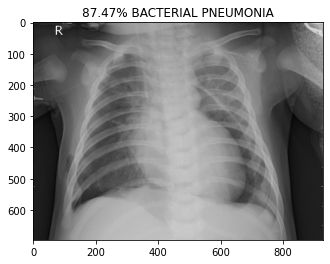

prob:[0.6235481 0.3764519]
BACTERIA/person596_bacteria_2445.jpeg


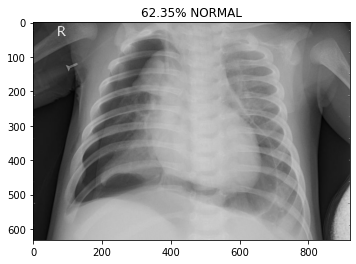

prob:[0.9843961  0.01560397]
BACTERIA/person596_bacteria_2446.jpeg


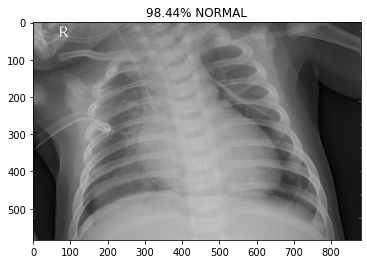

prob:[0.9813875  0.01861252]
BACTERIA/person596_bacteria_2447.jpeg


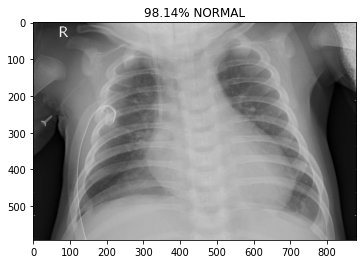

prob:[0.1750109 0.8249891]
BACTERIA/person596_bacteria_2449.jpeg


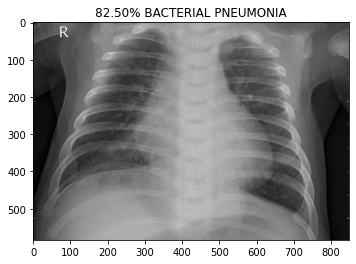

prob:[0.94928795 0.05071206]
BACTERIA/person597_bacteria_2450.jpeg


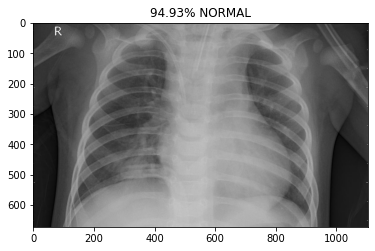

prob:[0.3984661 0.6015339]
BACTERIA/person597_bacteria_2451.jpeg


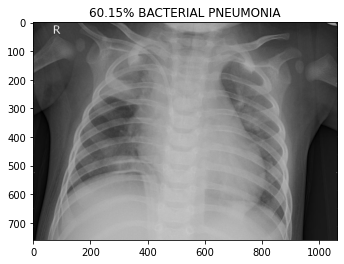

prob:[0.9508856  0.04911445]
BACTERIA/person598_bacteria_2453.jpeg


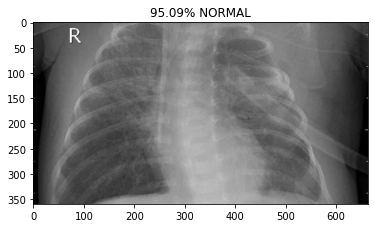

prob:[0.13953108 0.8604689 ]
BACTERIA/person598_bacteria_2454.jpeg


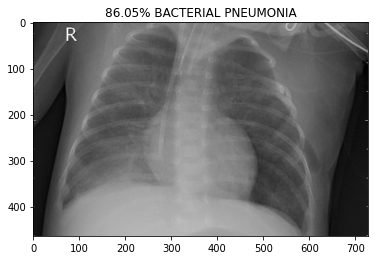

prob:[0.977517   0.02248299]
BACTERIA/person599_bacteria_2455.jpeg


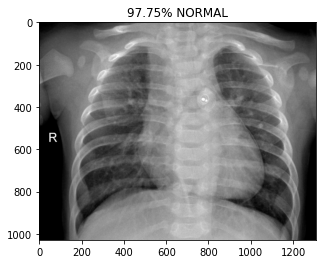

prob:[0.9710192  0.02898075]
BACTERIA/person600_bacteria_2456.jpeg


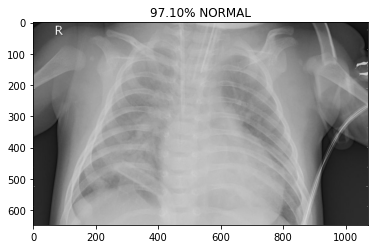

prob:[0.09300381 0.9069962 ]
BACTERIA/person600_bacteria_2457.jpeg


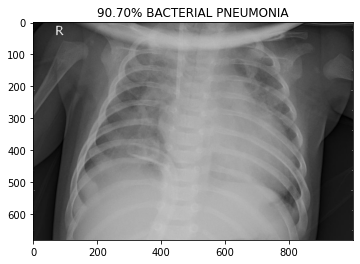

prob:[0.97499245 0.02500758]
BACTERIA/person600_bacteria_2458.jpeg


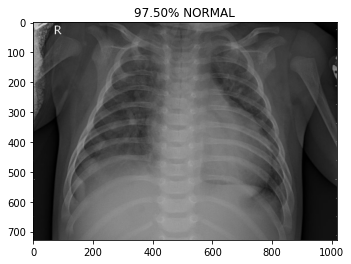

prob:[0.9920474  0.00795254]
BACTERIA/person601_bacteria_2459.jpeg


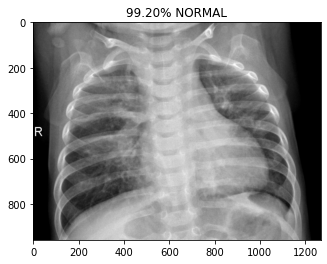

prob:[0.2903341 0.7096659]
BACTERIA/person602_bacteria_2460.jpeg


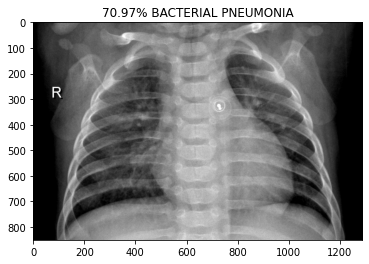

prob:[0.17209944 0.8279005 ]
BACTERIA/person603_bacteria_2461.jpeg


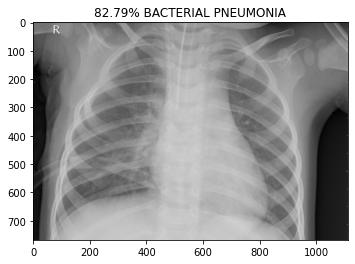

prob:[0.9836642  0.01633578]
BACTERIA/person604_bacteria_2462.jpeg


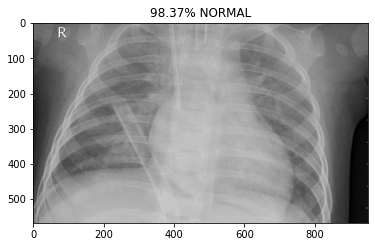

prob:[0.9464985  0.05350151]
BACTERIA/person604_bacteria_2463.jpeg


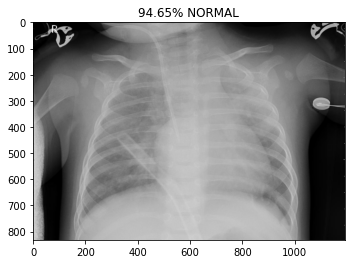

prob:[0.94936585 0.05063419]
BACTERIA/person605_bacteria_2464.jpeg


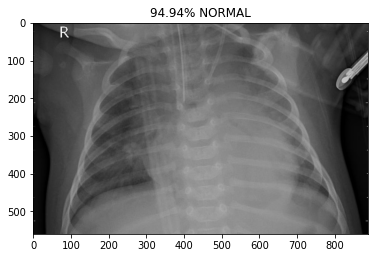

prob:[0.97708726 0.02291276]
BACTERIA/person605_bacteria_2465.jpeg


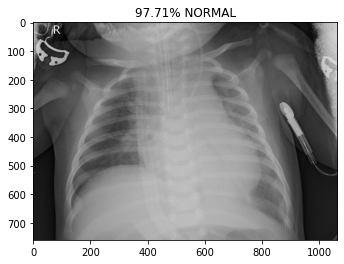

prob:[0.97789896 0.02210104]
BACTERIA/person605_bacteria_2466.jpeg


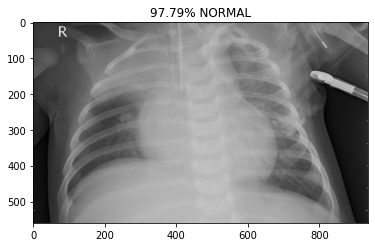

prob:[0.13470562 0.86529434]
BACTERIA/person605_bacteria_2467.jpeg


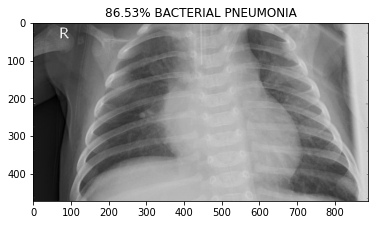

prob:[0.9663452  0.03365484]
BACTERIA/person605_bacteria_2468.jpeg


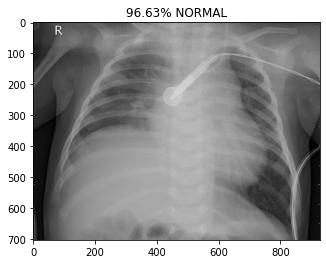

prob:[0.9825476  0.01745238]
BACTERIA/person606_bacteria_2469.jpeg


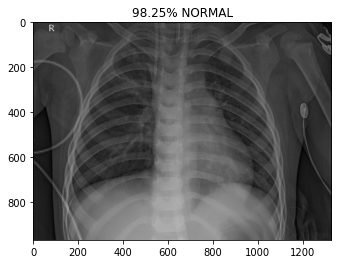

prob:[0.5811584  0.41884154]
BACTERIA/person607_bacteria_2470.jpeg


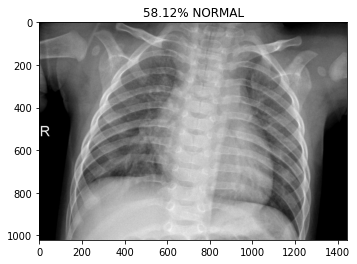

prob:[0.9547129  0.04528705]
BACTERIA/person608_bacteria_2471.jpeg


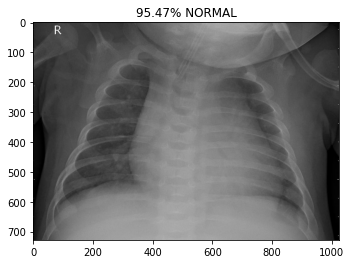

prob:[0.1194151  0.88058496]
BACTERIA/person608_bacteria_2472.jpeg


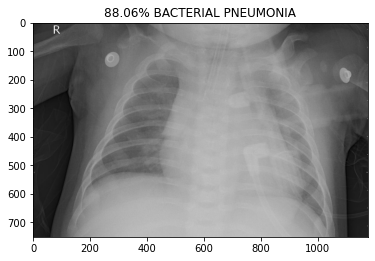

prob:[0.05035087 0.94964916]
BACTERIA/person608_bacteria_2473.jpeg


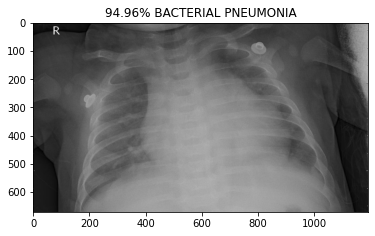

prob:[0.17614806 0.82385194]
BACTERIA/person609_bacteria_2474.jpeg


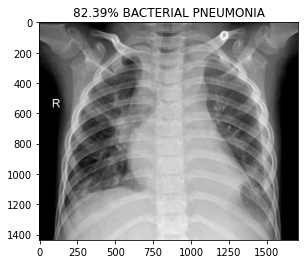

prob:[0.97804284 0.02195715]
BACTERIA/person610_bacteria_2475.jpeg


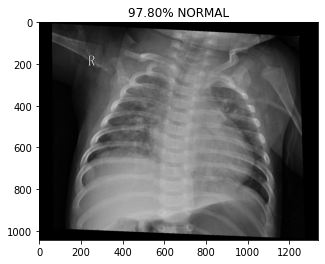

prob:[0.13656068 0.86343926]
BACTERIA/person611_bacteria_2476.jpeg


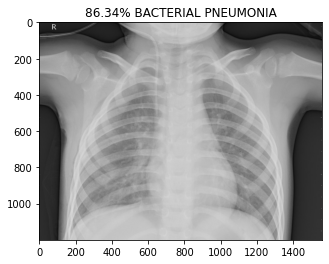

prob:[0.88817436 0.11182562]
BACTERIA/person612_bacteria_2477.jpeg


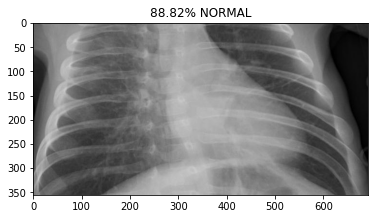

prob:[0.14333749 0.8566625 ]
BACTERIA/person612_bacteria_2478.jpeg


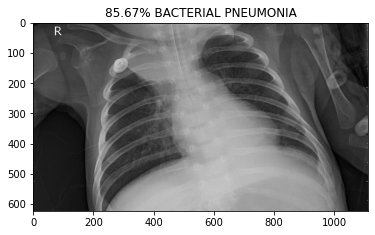

prob:[0.98271537 0.0172846 ]
BACTERIA/person613_bacteria_2479.jpeg


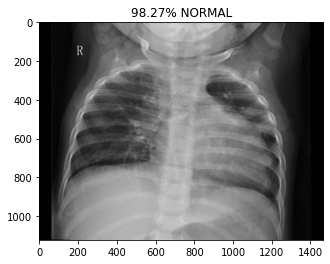

prob:[0.23388763 0.7661124 ]
BACTERIA/person614_bacteria_2480.jpeg


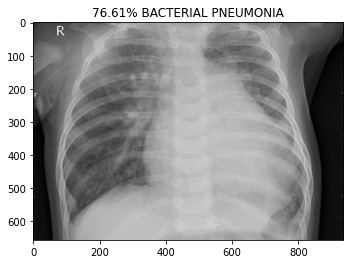

prob:[0.18084766 0.8191523 ]
BACTERIA/person614_bacteria_2481.jpeg


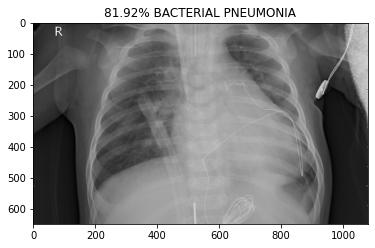

prob:[0.9514204  0.04857955]
BACTERIA/person614_bacteria_2483.jpeg


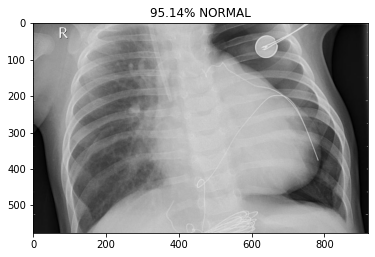

prob:[0.9918493 0.0081507]
BACTERIA/person616_bacteria_2487.jpeg


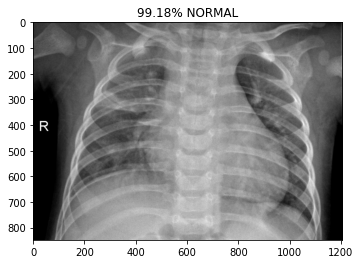

prob:[0.95995325 0.0400468 ]
BACTERIA/person617_bacteria_2488.jpeg


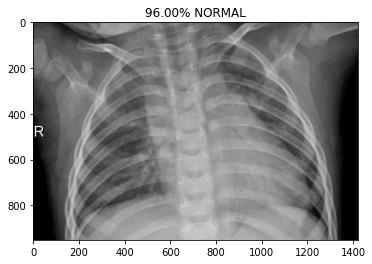

prob:[0.9833816  0.01661835]
BACTERIA/person618_bacteria_2489.jpeg


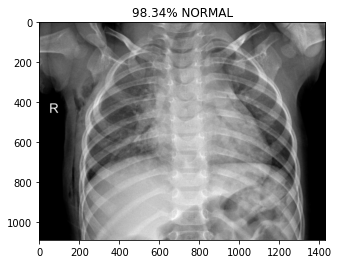

prob:[0.5098566  0.49014342]
BACTERIA/person619_bacteria_2490.jpeg


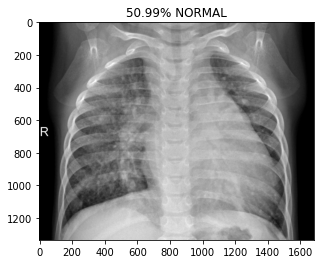

prob:[0.15692726 0.8430727 ]
BACTERIA/person619_bacteria_2491.jpeg


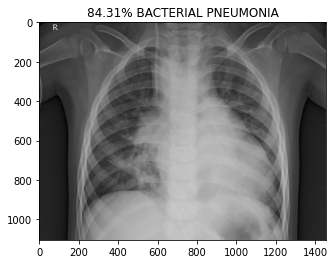

prob:[0.96131426 0.03868571]
BACTERIA/person620_bacteria_2492.jpeg


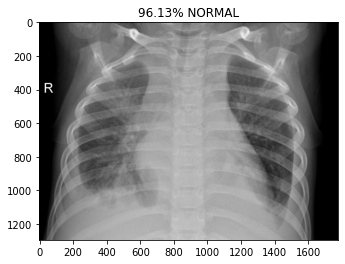

prob:[0.08144303 0.918557  ]
BACTERIA/person622_bacteria_2494.jpeg


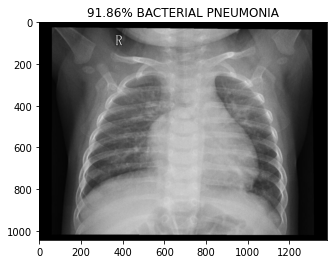

prob:[0.03918432 0.96081567]
BACTERIA/person623_bacteria_2495.jpeg


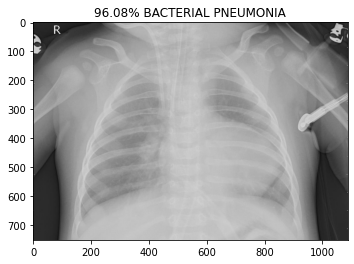

prob:[0.96503633 0.03496367]
BACTERIA/person623_bacteria_2496.jpeg


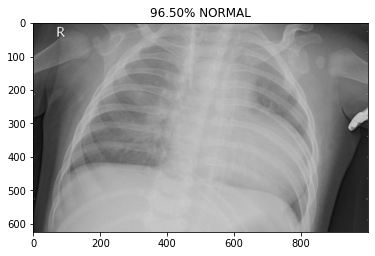

prob:[0.37116405 0.6288359 ]
BACTERIA/person624_bacteria_2497.jpeg


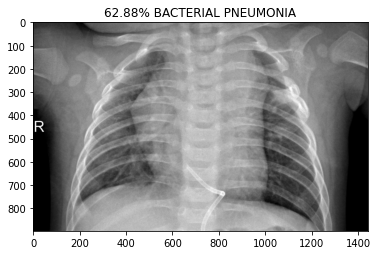

prob:[0.91164976 0.08835022]
BACTERIA/person625_bacteria_2499.jpeg


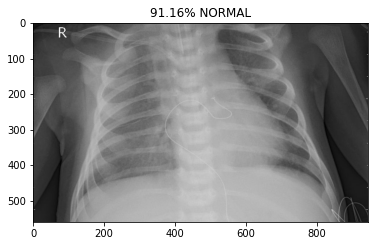

prob:[0.18408339 0.81591666]
BACTERIA/person625_bacteria_2500.jpeg


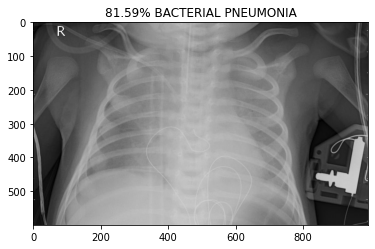

prob:[0.53625715 0.46374288]
BACTERIA/person626_bacteria_2502.jpeg


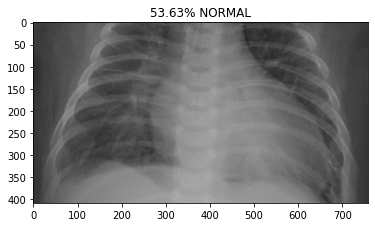

prob:[0.98050714 0.01949288]
BACTERIA/person628_bacteria_2505.jpeg


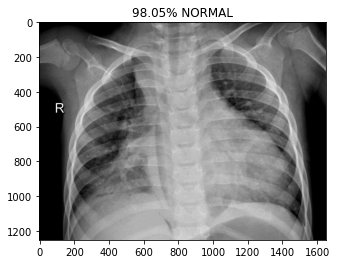

prob:[0.92827547 0.0717246 ]
BACTERIA/person629_bacteria_2506.jpeg


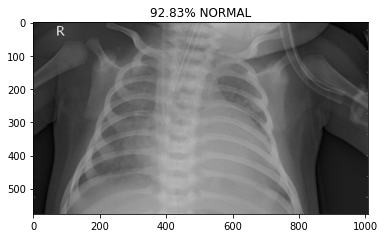

prob:[0.1325633 0.8674367]
BACTERIA/person629_bacteria_2507.jpeg


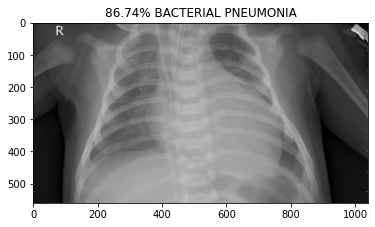

prob:[0.20133269 0.7986673 ]
BACTERIA/person629_bacteria_2508.jpeg


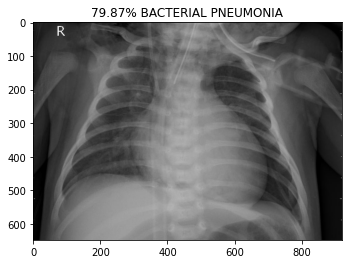

prob:[0.10996069 0.8900393 ]
BACTERIA/person629_bacteria_2509.jpeg


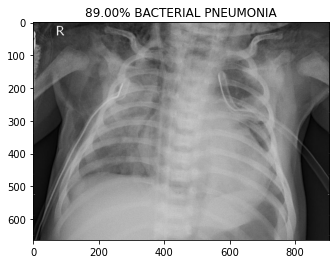

prob:[0.6608928  0.33910725]
BACTERIA/person629_bacteria_2510.jpeg


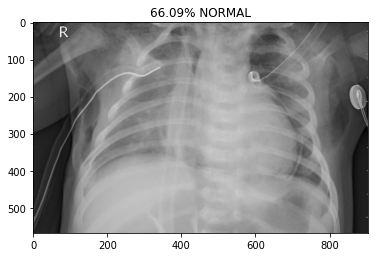

prob:[0.15529478 0.8447052 ]
BACTERIA/person630_bacteria_2512.jpeg


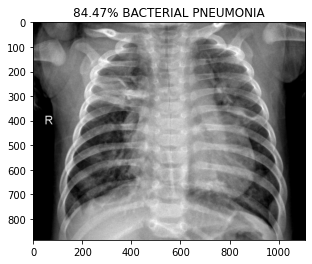

prob:[0.0317604 0.9682396]
BACTERIA/person630_bacteria_2513.jpeg


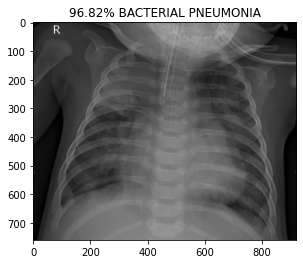

prob:[0.7827903  0.21720967]
BACTERIA/person630_bacteria_2514.jpeg


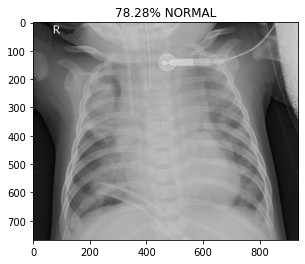

prob:[0.80705285 0.19294718]
BACTERIA/person630_bacteria_2515.jpeg


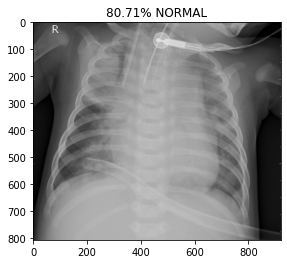

prob:[0.19593032 0.8040697 ]
BACTERIA/person630_bacteria_2516.jpeg


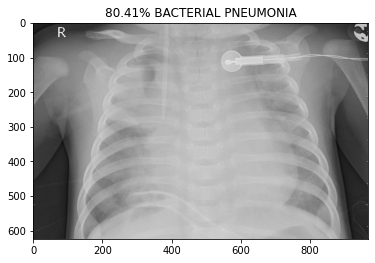

prob:[0.98268825 0.01731182]
BACTERIA/person632_bacteria_2520.jpeg


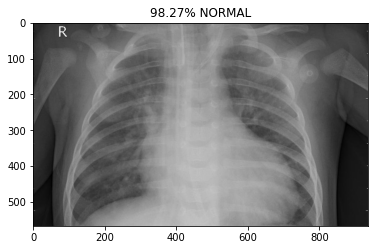

prob:[0.98846775 0.01153221]
BACTERIA/person632_bacteria_2521.jpeg


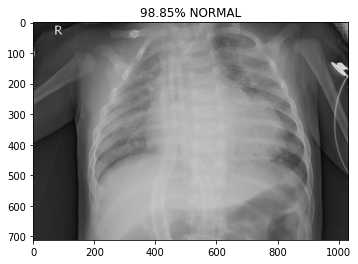

prob:[0.95650554 0.04349442]
BACTERIA/person633_bacteria_2522.jpeg


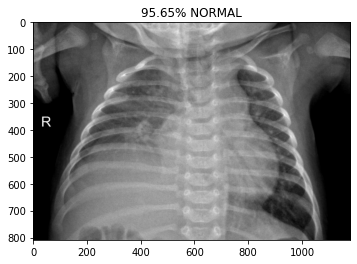

prob:[0.9805117  0.01948832]
BACTERIA/person634_bacteria_2525.jpeg


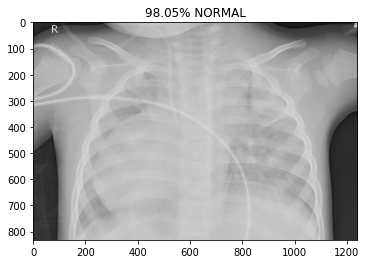

prob:[0.21738501 0.78261495]
BACTERIA/person635_bacteria_2526.jpeg


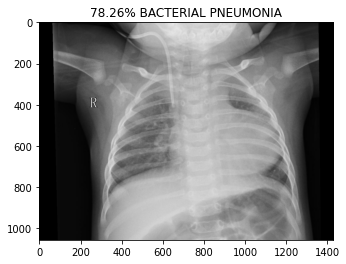

prob:[0.23080386 0.76919615]
BACTERIA/person636_bacteria_2527.jpeg


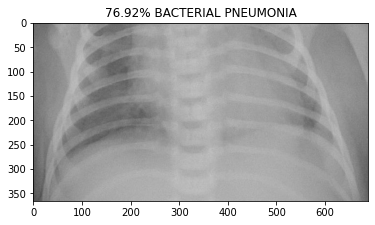

prob:[0.98550725 0.0144928 ]
BACTERIA/person637_bacteria_2528.jpeg


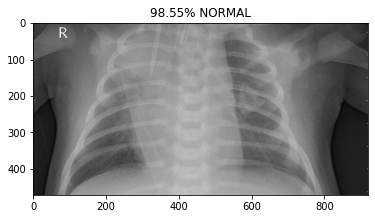

prob:[0.36119464 0.6388053 ]
BACTERIA/person637_bacteria_2529.jpeg


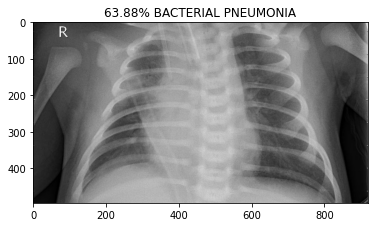

prob:[0.20031147 0.7996885 ]
BACTERIA/person640_bacteria_2532.jpeg


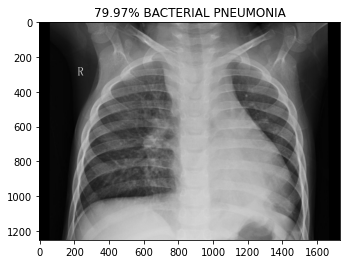

prob:[0.06806104 0.93193895]
BACTERIA/person641_bacteria_2533.jpeg


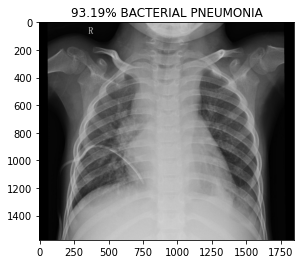

prob:[0.9784802  0.02151975]
BACTERIA/person643_bacteria_2534.jpeg


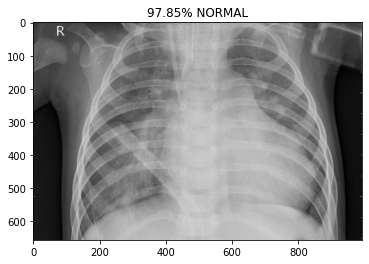

prob:[0.9900866 0.0099134]
BACTERIA/person644_bacteria_2536.jpeg


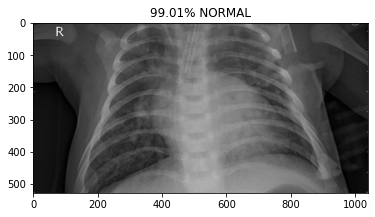

prob:[0.18897812 0.8110219 ]
BACTERIA/person645_bacteria_2537.jpeg


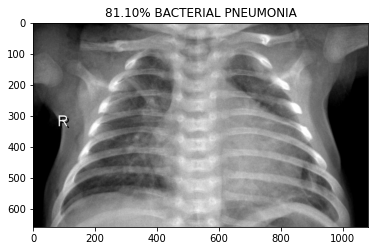

prob:[0.07479064 0.9252094 ]
BACTERIA/person646_bacteria_2538.jpeg


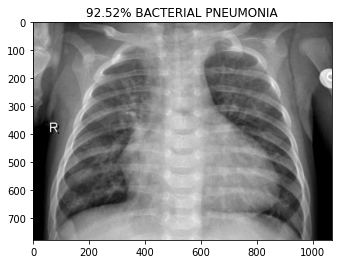

prob:[0.09560033 0.90439963]
BACTERIA/person647_bacteria_2539.jpeg


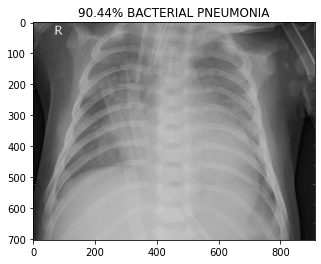

prob:[0.99383074 0.00616933]
BACTERIA/person648_bacteria_2540.jpeg


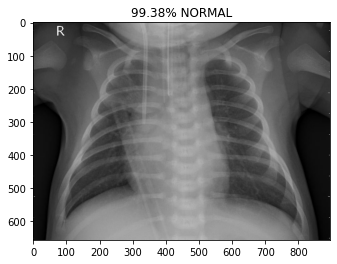

prob:[0.04758986 0.95241016]
BACTERIA/person649_bacteria_2541.jpeg


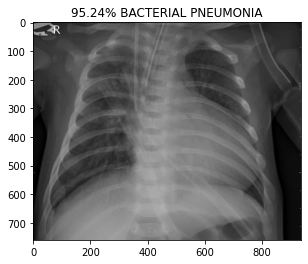

prob:[0.7914831  0.20851696]
BACTERIA/person650_bacteria_2542.jpeg


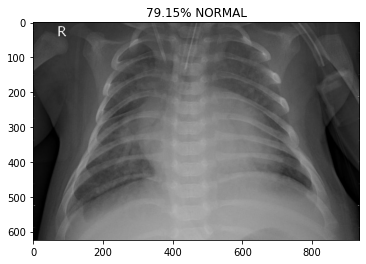

prob:[0.96426946 0.03573055]
BACTERIA/person651_bacteria_2543.jpeg


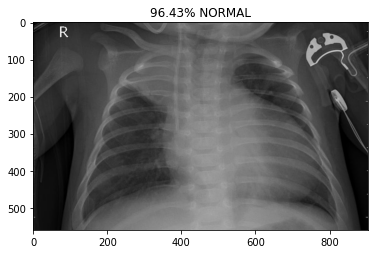

prob:[0.06578857 0.9342115 ]
BACTERIA/person652_bacteria_2544.jpeg


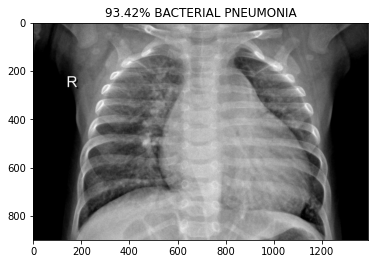

prob:[0.2392383 0.7607617]
BACTERIA/person653_bacteria_2545.jpeg


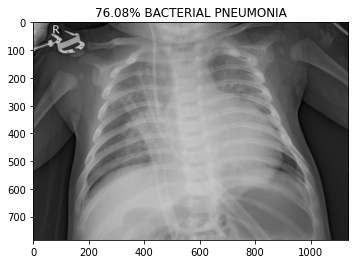

prob:[0.33606896 0.663931  ]
BACTERIA/person654_bacteria_2546.jpeg


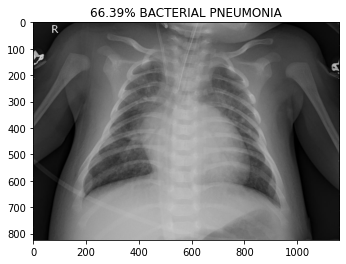

prob:[0.19198869 0.80801123]
BACTERIA/person655_bacteria_2547.jpeg


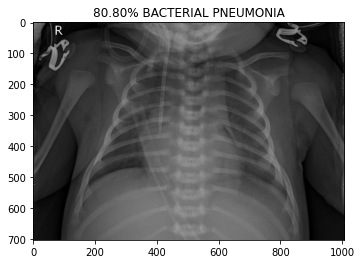

prob:[0.9457512  0.05424879]
BACTERIA/person656_bacteria_2548.jpeg


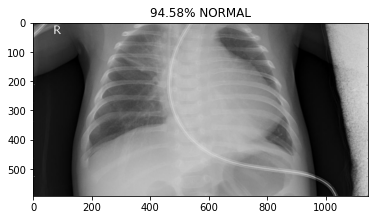

prob:[0.93273324 0.06726675]
BACTERIA/person657_bacteria_2549.jpeg


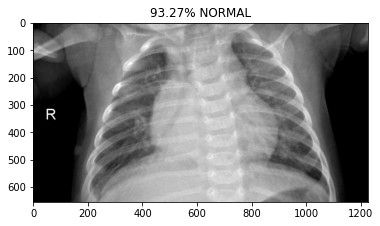

prob:[0.02902328 0.97097677]
BACTERIA/person658_bacteria_2550.jpeg


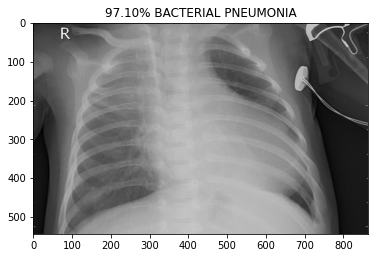

prob:[0.1781121 0.8218879]
BACTERIA/person659_bacteria_2551.jpeg


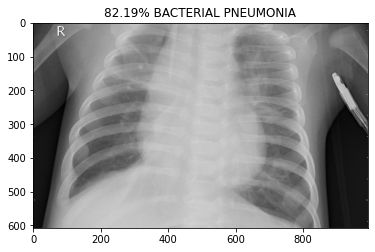

prob:[0.9666627  0.03333734]
BACTERIA/person660_bacteria_2552.jpeg


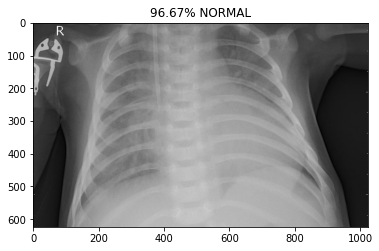

prob:[0.11946543 0.8805346 ]
BACTERIA/person661_bacteria_2553.jpeg


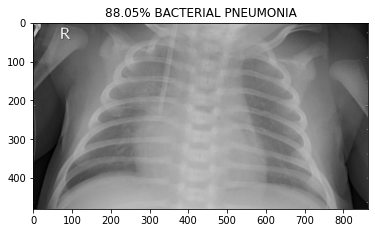

prob:[0.9872958  0.01270426]
BACTERIA/person662_bacteria_2554.jpeg


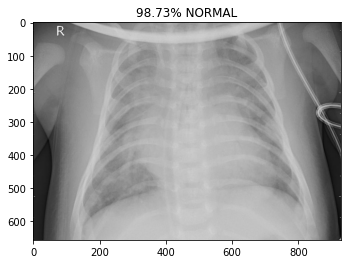

prob:[0.97983474 0.02016523]
BACTERIA/person663_bacteria_2555.jpeg


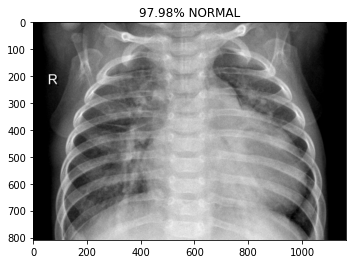

prob:[0.51548874 0.4845113 ]
BACTERIA/person665_bacteria_2557.jpeg


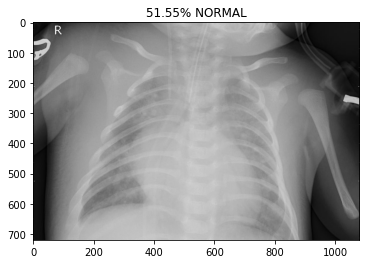

prob:[0.09590163 0.9040984 ]
BACTERIA/person666_bacteria_2558.jpeg


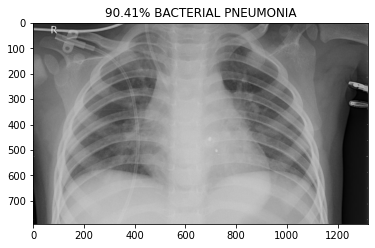

prob:[0.14944863 0.85055137]
BACTERIA/person669_bacteria_2561.jpeg


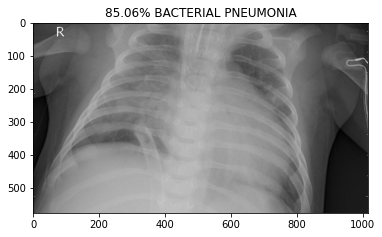

prob:[0.9803719 0.0196281]
BACTERIA/person669_bacteria_2562.jpeg


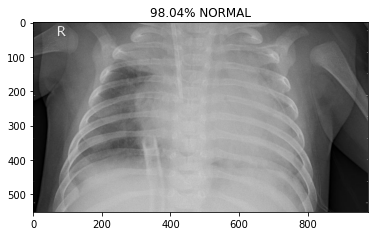

prob:[0.7480508  0.25194922]
BACTERIA/person670_bacteria_2563.jpeg


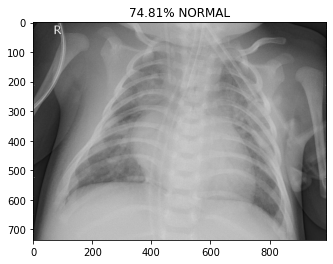

prob:[0.1253177  0.87468225]
BACTERIA/person671_bacteria_2564.jpeg


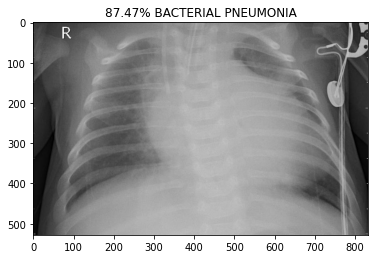

prob:[0.8351105  0.16488954]
BACTERIA/person672_bacteria_2565.jpeg


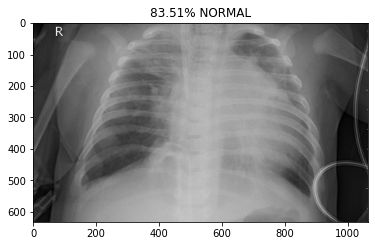

prob:[0.09519585 0.90480417]
BACTERIA/person673_bacteria_2566.jpeg


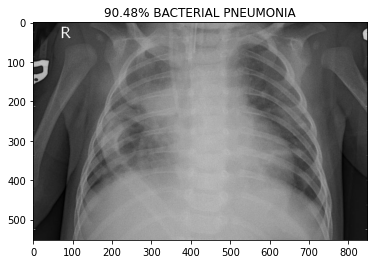

prob:[0.21464011 0.78535986]
BACTERIA/person674_bacteria_2568.jpeg


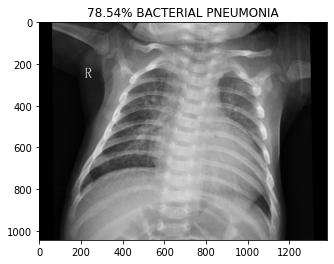

prob:[0.8704044  0.12959555]
BACTERIA/person675_bacteria_2569.jpeg


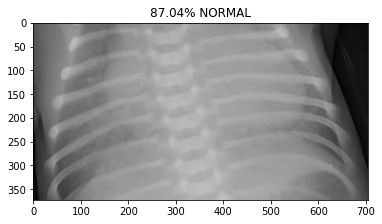

prob:[0.19065784 0.80934215]
BACTERIA/person677_bacteria_2571.jpeg


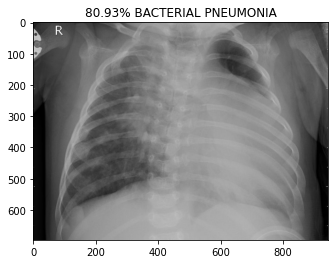

prob:[0.5511951  0.44880497]
BACTERIA/person678_bacteria_2572.jpeg


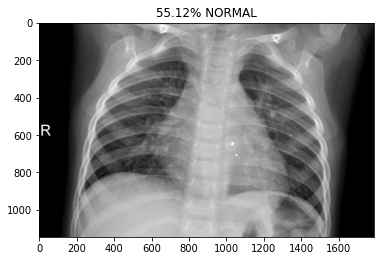

prob:[0.9867568  0.01324315]
BACTERIA/person680_bacteria_2575.jpeg


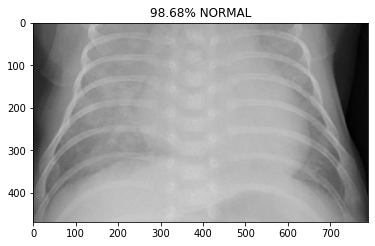

prob:[0.02930027 0.97069967]
BACTERIA/person681_bacteria_2576.jpeg


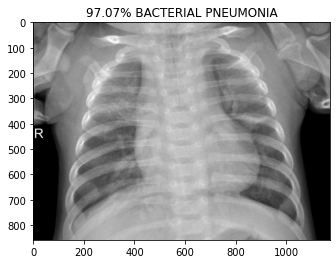

prob:[0.507259 0.492741]
BACTERIA/person683_bacteria_2578.jpeg


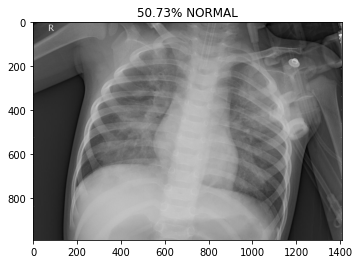

prob:[0.97929335 0.02070668]
BACTERIA/person684_bacteria_2580.jpeg


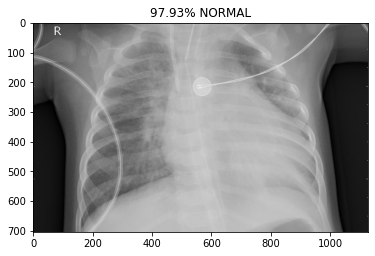

prob:[0.16149001 0.83851   ]
BACTERIA/person685_bacteria_2581.jpeg


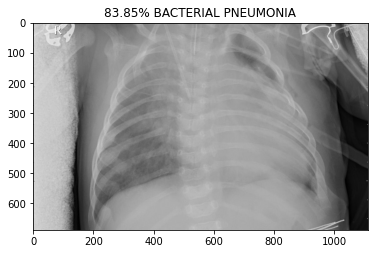

prob:[0.03232468 0.9676753 ]
BACTERIA/person687_bacteria_2583.jpeg


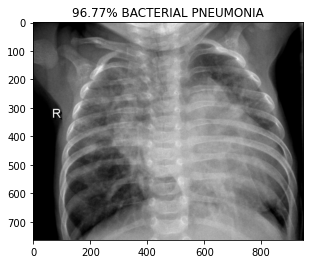

prob:[0.9436822 0.0563178]
BACTERIA/person688_bacteria_2584.jpeg


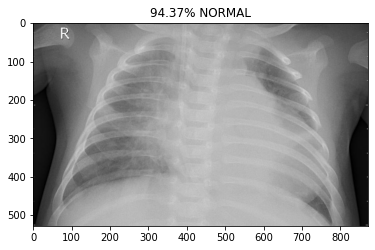

prob:[0.91419595 0.08580402]
BACTERIA/person689_bacteria_2585.jpeg


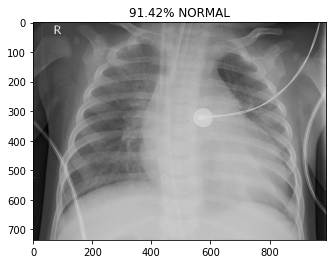

prob:[0.97654516 0.02345486]
BACTERIA/person689_bacteria_2586.jpeg


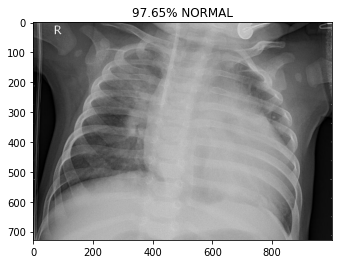

prob:[0.89562726 0.10437272]
BACTERIA/person690_bacteria_2587.jpeg


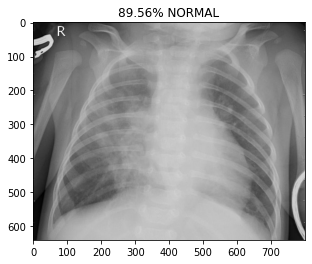

prob:[0.09745603 0.90254396]
BACTERIA/person691_bacteria_2588.jpeg


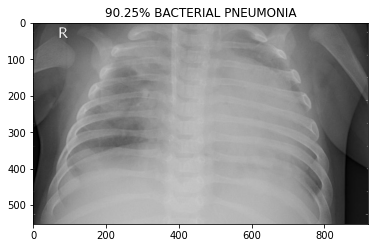

prob:[0.7257218  0.27427816]
BACTERIA/person692_bacteria_2589.jpeg


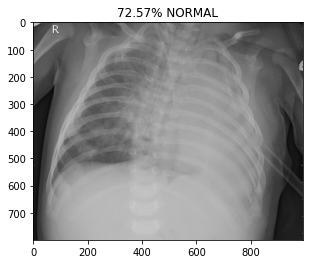

prob:[0.21203358 0.7879664 ]
BACTERIA/person693_bacteria_2590.jpeg


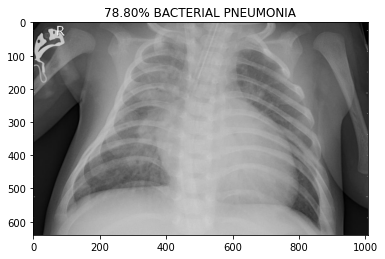

prob:[0.06735774 0.9326423 ]
BACTERIA/person696_bacteria_2594.jpeg


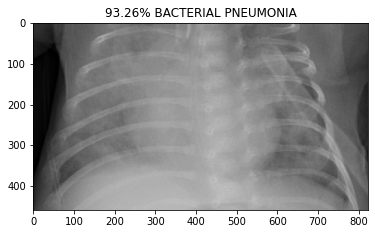

prob:[0.94708484 0.05291516]
BACTERIA/person699_bacteria_2598.jpeg


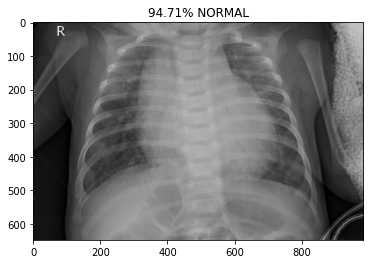

prob:[0.9867561  0.01324391]
BACTERIA/person700_bacteria_2599.jpeg


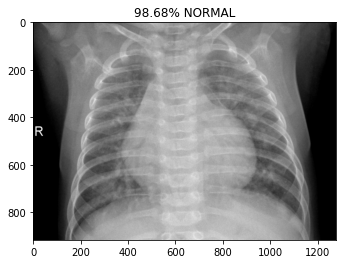

prob:[0.9379099  0.06209011]
BACTERIA/person701_bacteria_2600.jpeg


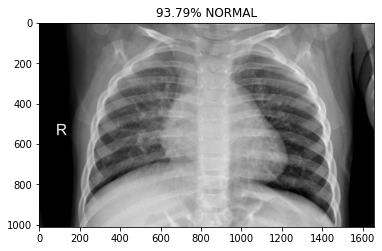

prob:[0.36186874 0.63813126]
BACTERIA/person702_bacteria_2601.jpeg


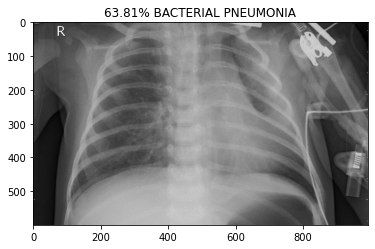

prob:[0.946016   0.05398394]
BACTERIA/person703_bacteria_2602.jpeg


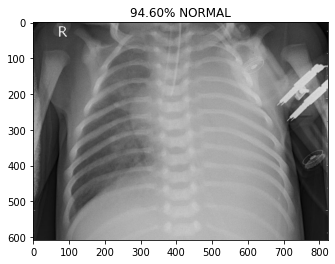

prob:[0.9766941  0.02330593]
BACTERIA/person704_bacteria_2603.jpeg


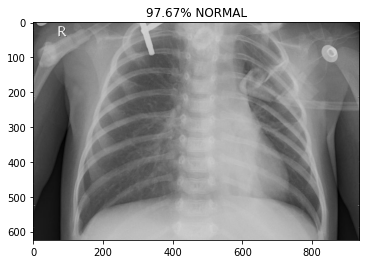

prob:[0.9464154  0.05358456]
BACTERIA/person707_bacteria_2606.jpeg


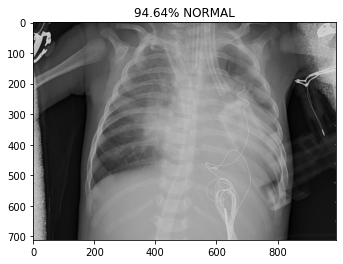

prob:[0.09401157 0.90598845]
BACTERIA/person709_bacteria_2608.jpeg


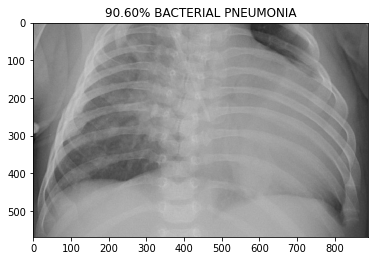

prob:[0.1704293 0.8295707]
BACTERIA/person710_bacteria_2611.jpeg


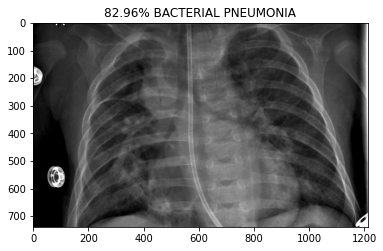

prob:[0.9800448  0.01995521]
BACTERIA/person711_bacteria_2612.jpeg


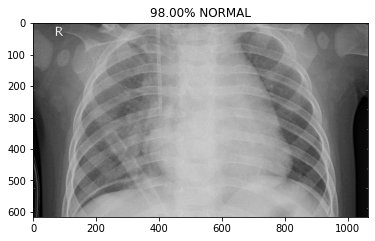

prob:[0.0583534  0.94164664]
BACTERIA/person712_bacteria_2613.jpeg


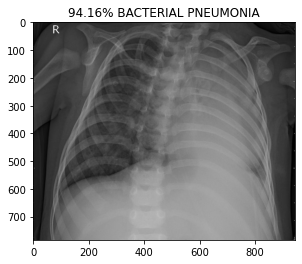

prob:[0.05857468 0.9414253 ]
BACTERIA/person713_bacteria_2614.jpeg


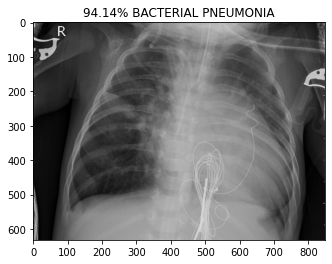

prob:[0.2245597  0.77544034]
BACTERIA/person714_bacteria_2615.jpeg


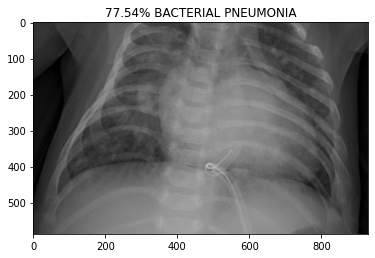

prob:[0.956754   0.04324594]
BACTERIA/person716_bacteria_2617.jpeg


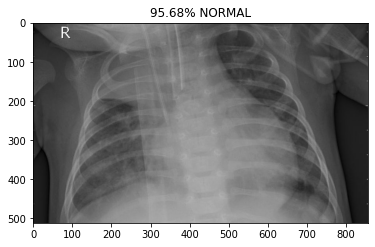

prob:[0.9498026  0.05019738]
BACTERIA/person717_bacteria_2618.jpeg


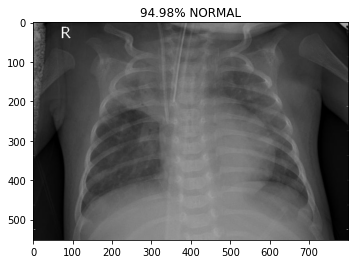

prob:[0.99143136 0.00856856]
BACTERIA/person718_bacteria_2620.jpeg


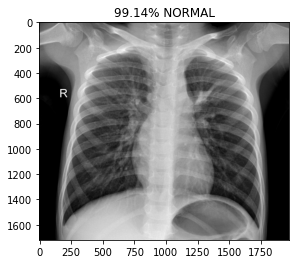

prob:[0.11720558 0.8827944 ]
BACTERIA/person719_bacteria_2621.jpeg


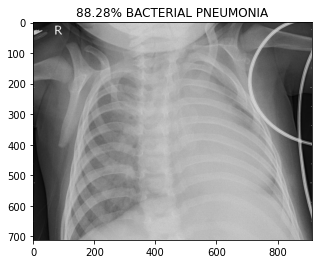

prob:[0.9501393  0.04986073]
BACTERIA/person720_bacteria_2622.jpeg


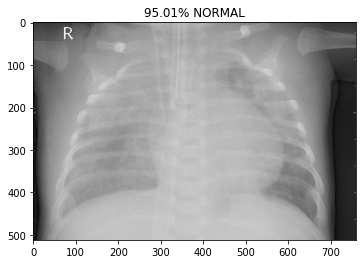

prob:[0.15177836 0.8482217 ]
BACTERIA/person721_bacteria_2623.jpeg


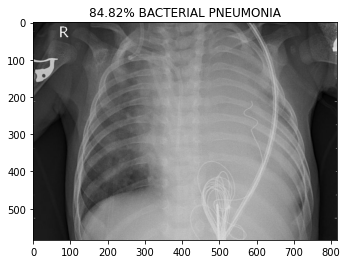

prob:[0.50540173 0.49459833]
BACTERIA/person723_bacteria_2625.jpeg


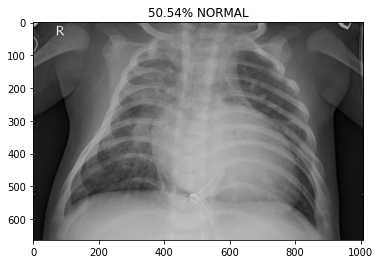

prob:[0.29306507 0.7069349 ]
BACTERIA/person724_bacteria_2626.jpeg


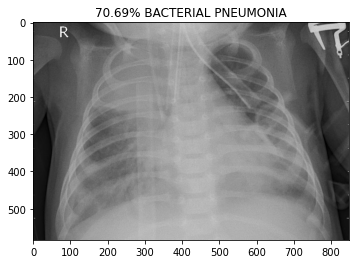

prob:[0.9799457  0.02005423]
BACTERIA/person725_bacteria_2627.jpeg


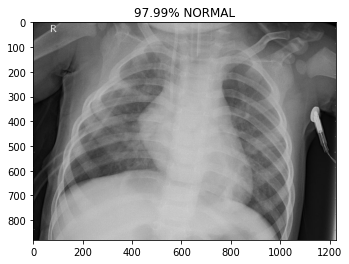

prob:[0.98709446 0.01290557]
BACTERIA/person726_bacteria_2628.jpeg


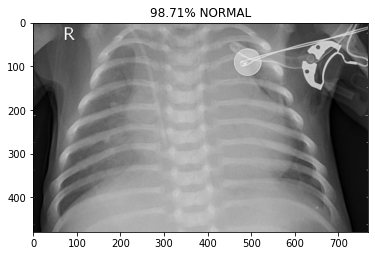

prob:[0.29010922 0.70989084]
BACTERIA/person727_bacteria_2629.jpeg


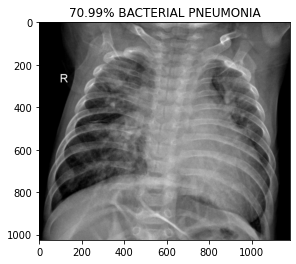

prob:[0.18590285 0.81409717]
BACTERIA/person728_bacteria_2630.jpeg


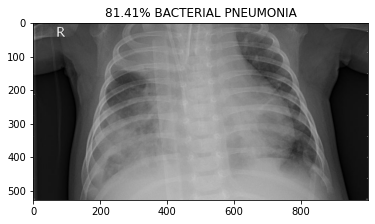

prob:[0.14021434 0.8597857 ]
BACTERIA/person730_bacteria_2632.jpeg


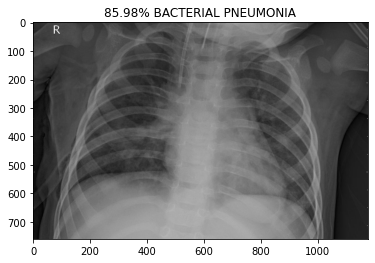

prob:[0.8623225  0.13767748]
BACTERIA/person731_bacteria_2633.jpeg


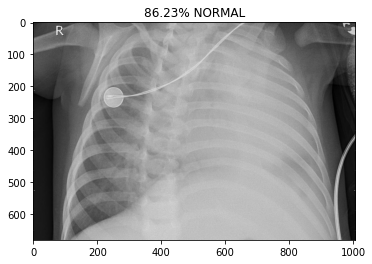

prob:[0.97955716 0.02044289]
BACTERIA/person732_bacteria_2634.jpeg


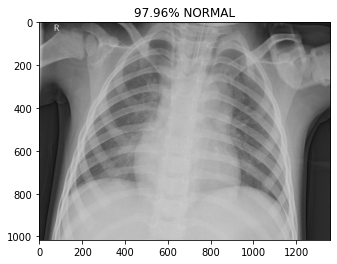

prob:[0.11225662 0.8877434 ]
BACTERIA/person733_bacteria_2635.jpeg


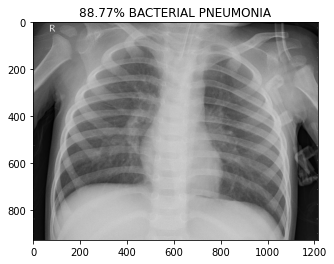

prob:[0.04544283 0.9545571 ]
BACTERIA/person734_bacteria_2637.jpeg


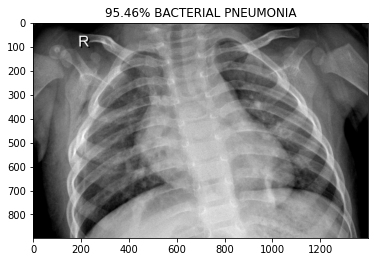

prob:[0.8070522  0.19294779]
BACTERIA/person735_bacteria_2638.jpeg


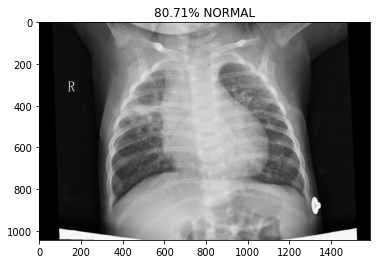

prob:[0.9637027  0.03629729]
BACTERIA/person736_bacteria_2639.jpeg


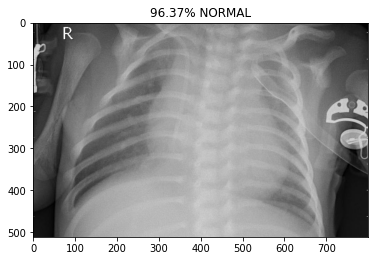

prob:[0.05792425 0.9420757 ]
BACTERIA/person737_bacteria_2640.jpeg


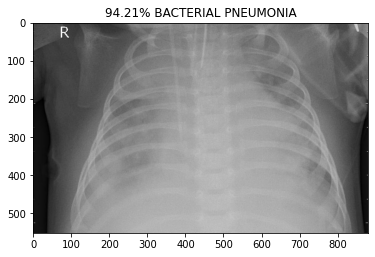

prob:[0.12525243 0.8747476 ]
BACTERIA/person738_bacteria_2641.jpeg


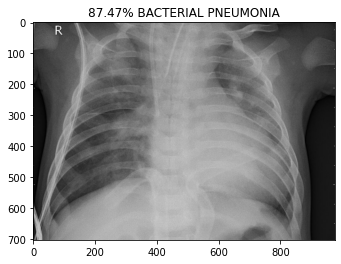

prob:[0.9393588  0.06064123]
BACTERIA/person739_bacteria_2642.jpeg


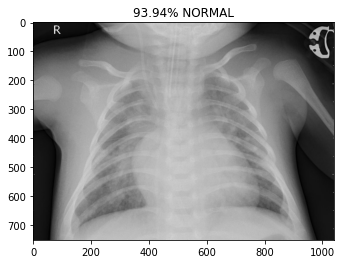

prob:[0.24525045 0.75474954]
BACTERIA/person740_bacteria_2643.jpeg


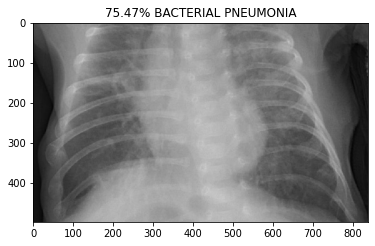

prob:[0.10264277 0.89735717]
BACTERIA/person741_bacteria_2644.jpeg


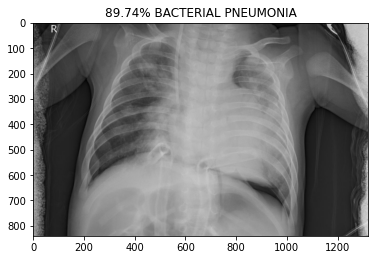

prob:[0.06502566 0.9349743 ]
BACTERIA/person743_bacteria_2646.jpeg


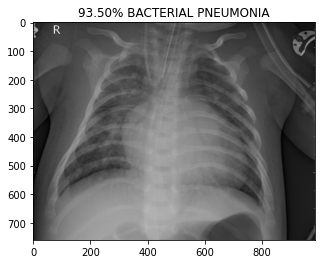

prob:[0.975524   0.02447601]
BACTERIA/person744_bacteria_2647.jpeg


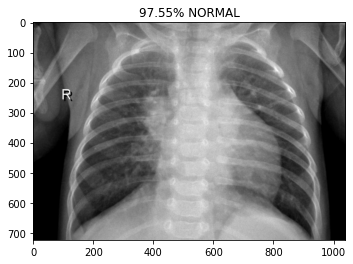

prob:[0.5962672  0.40373275]
BACTERIA/person745_bacteria_2648.jpeg


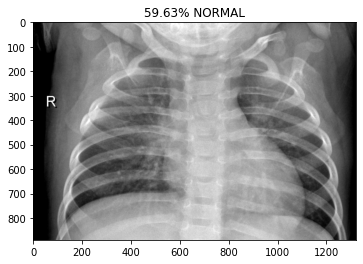

prob:[0.91864234 0.08135774]
BACTERIA/person746_bacteria_2649.jpeg


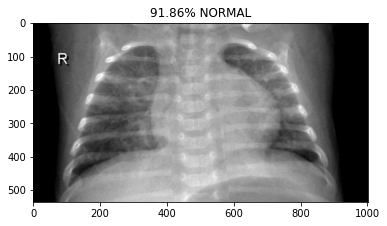

prob:[0.99181694 0.00818309]
BACTERIA/person747_bacteria_2650.jpeg


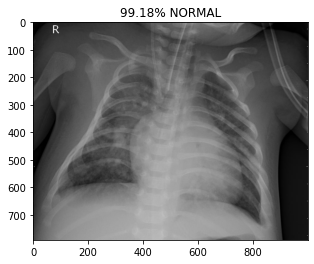

prob:[0.10768086 0.8923191 ]
BACTERIA/person749_bacteria_2652.jpeg


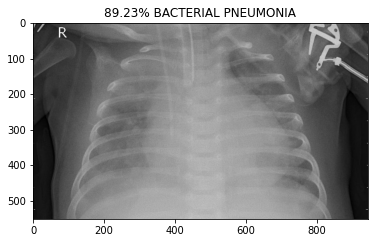

prob:[0.95444757 0.0455525 ]
BACTERIA/person750_bacteria_2653.jpeg


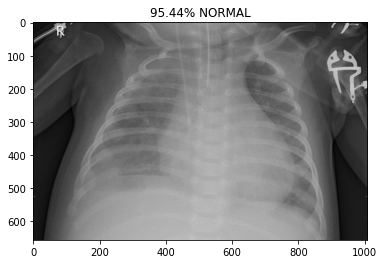

prob:[0.70283675 0.29716328]
BACTERIA/person751_bacteria_2654.jpeg


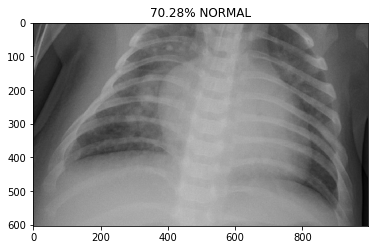

prob:[0.9817348  0.01826517]
BACTERIA/person753_bacteria_2656.jpeg


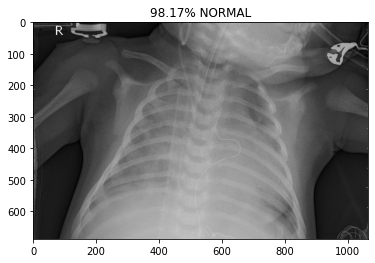

prob:[0.76486933 0.2351307 ]
BACTERIA/person755_bacteria_2659.jpeg


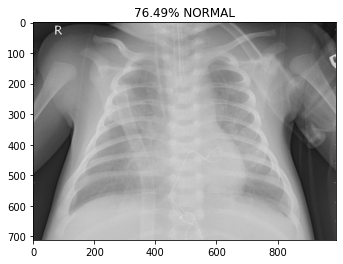

prob:[0.13630061 0.86369944]
BACTERIA/person756_bacteria_2660.jpeg


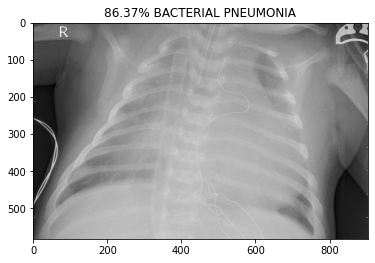

prob:[0.99368954 0.00631043]
BACTERIA/person757_bacteria_2661.jpeg


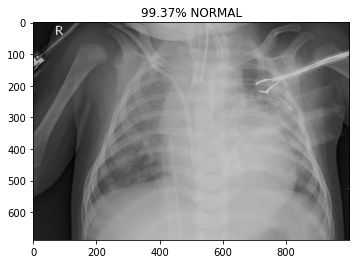

prob:[0.07552072 0.9244793 ]
BACTERIA/person758_bacteria_2662.jpeg


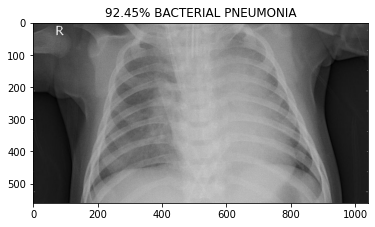

prob:[0.9883901  0.01160994]
BACTERIA/person759_bacteria_2663.jpeg


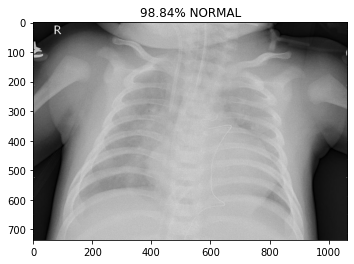

prob:[0.16570766 0.83429235]
BACTERIA/person760_bacteria_2664.jpeg


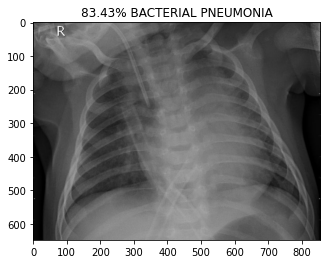

prob:[0.21737683 0.78262323]
BACTERIA/person761_bacteria_2665.jpeg


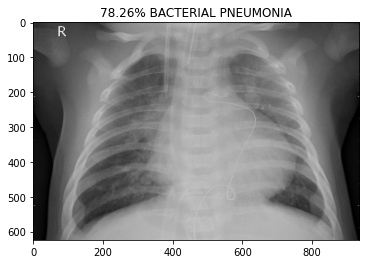

prob:[0.8551246  0.14487545]
BACTERIA/person763_bacteria_2667.jpeg


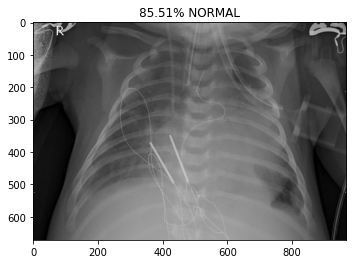

prob:[0.1319073 0.8680927]
BACTERIA/person764_bacteria_2668.jpeg


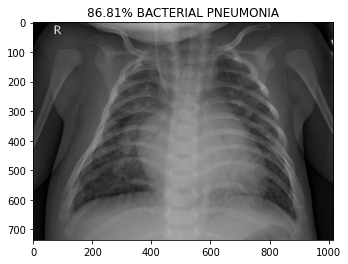

prob:[0.97927445 0.02072559]
BACTERIA/person765_bacteria_2669.jpeg


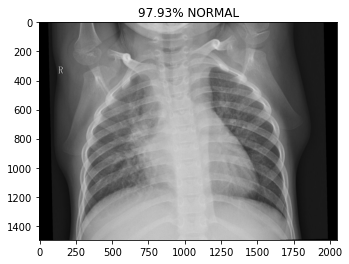

prob:[0.22704816 0.77295184]
BACTERIA/person766_bacteria_2670.jpeg


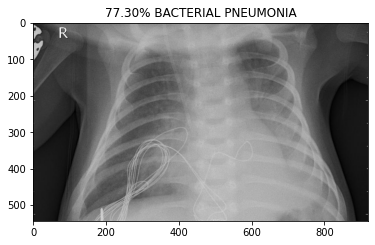

prob:[0.96678436 0.03321566]
BACTERIA/person767_bacteria_2671.jpeg


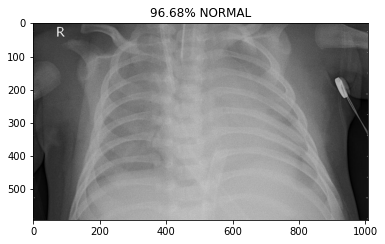

prob:[0.2071166 0.7928834]
BACTERIA/person768_bacteria_2672.jpeg


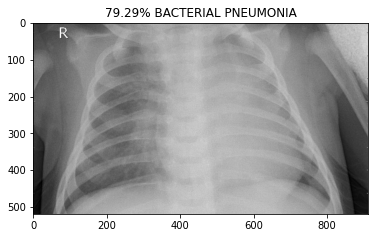

prob:[0.99004793 0.00995202]
BACTERIA/person769_bacteria_2673.jpeg


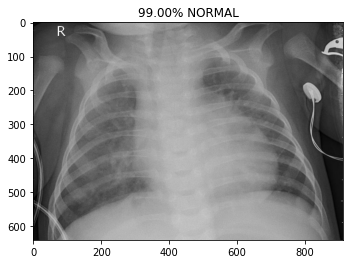

prob:[0.29488397 0.70511603]
BACTERIA/person770_bacteria_2674.jpeg


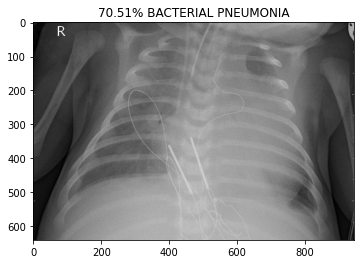

prob:[0.98868805 0.01131198]
BACTERIA/person771_bacteria_2675.jpeg


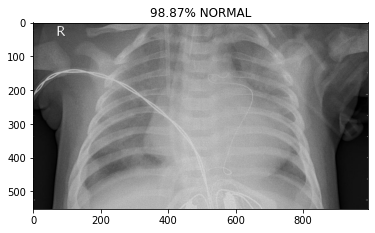

prob:[0.10994055 0.8900594 ]
BACTERIA/person774_bacteria_2678.jpeg


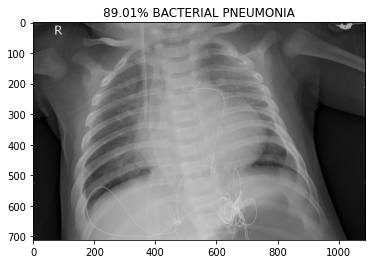

prob:[0.6539356  0.34606442]
BACTERIA/person775_bacteria_2679.jpeg


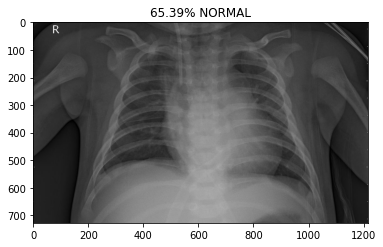

prob:[0.9795895  0.02041048]
BACTERIA/person776_bacteria_2680.jpeg


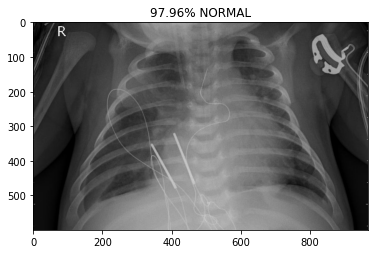

prob:[0.35721338 0.64278656]
BACTERIA/person778_bacteria_2682.jpeg


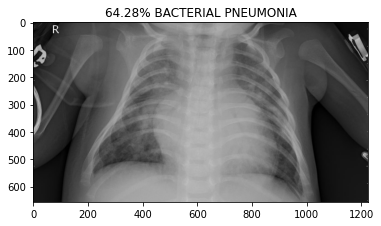

prob:[0.15832429 0.8416757 ]
BACTERIA/person779_bacteria_2683.jpeg


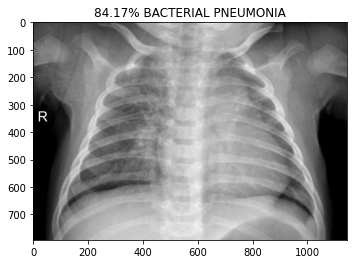

prob:[0.2012089  0.79879105]
BACTERIA/person780_bacteria_2684.jpeg


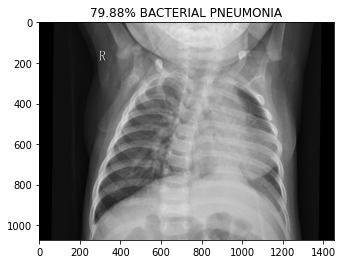

prob:[0.11923703 0.880763  ]
BACTERIA/person782_bacteria_2686.jpeg


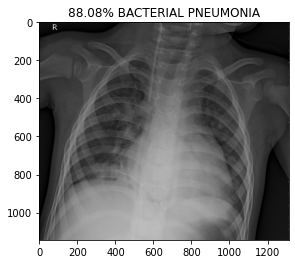

prob:[0.9597214  0.04027857]
BACTERIA/person783_bacteria_2687.jpeg


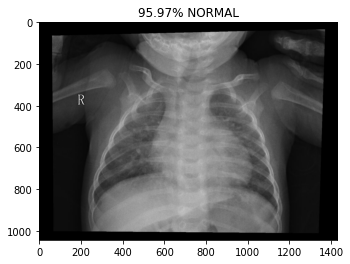

prob:[0.04494105 0.9550589 ]
BACTERIA/person785_bacteria_2689.jpeg


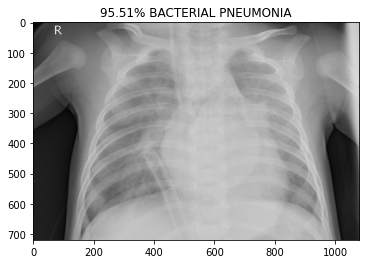

prob:[0.9762323  0.02376767]
BACTERIA/person786_bacteria_2690.jpeg


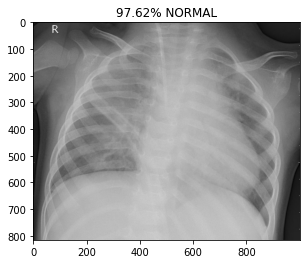

prob:[0.10991792 0.89008206]
BACTERIA/person787_bacteria_2691.jpeg


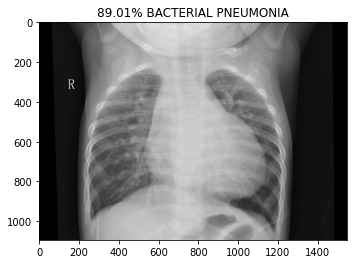

prob:[0.03762428 0.96237576]
BACTERIA/person789_bacteria_2694.jpeg


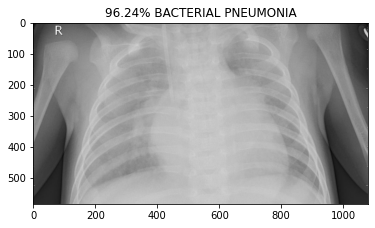

prob:[0.9095355  0.09046452]
BACTERIA/person794_bacteria_2700.jpeg


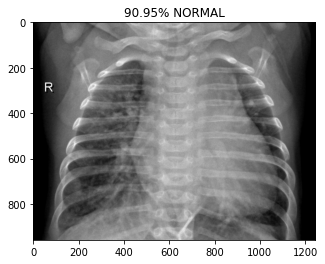

prob:[0.07935755 0.9206425 ]
BACTERIA/person796_bacteria_2702.jpeg


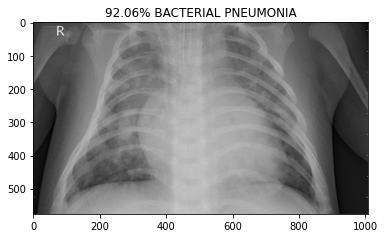

prob:[0.17032531 0.8296747 ]
BACTERIA/person799_bacteria_2705.jpeg


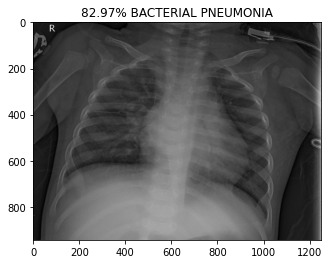

prob:[0.06505631 0.9349437 ]
BACTERIA/person800_bacteria_2706.jpeg


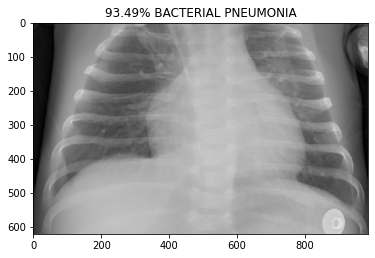

prob:[0.98908055 0.01091945]
BACTERIA/person802_bacteria_2708.jpeg


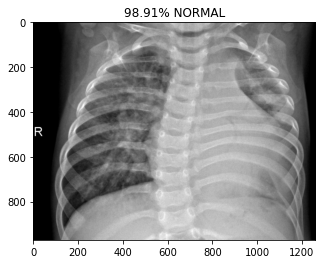

prob:[0.9743061  0.02569389]
BACTERIA/person803_bacteria_2710.jpeg


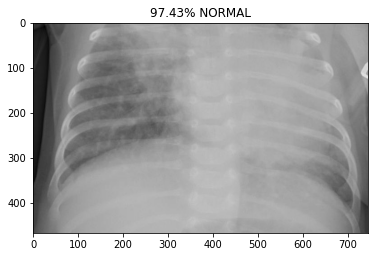

prob:[0.7096308  0.29036924]
BACTERIA/person804_bacteria_2711.jpeg


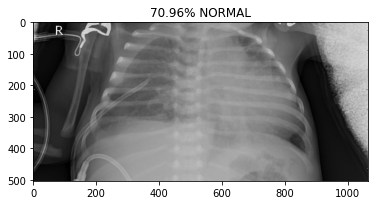

prob:[0.9833493 0.0166507]
BACTERIA/person805_bacteria_2712.jpeg


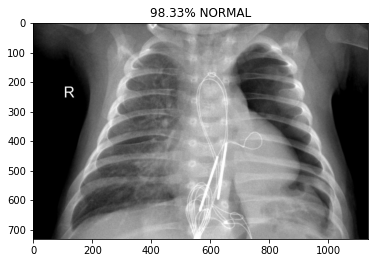

prob:[0.47616807 0.52383196]
BACTERIA/person808_bacteria_2716.jpeg


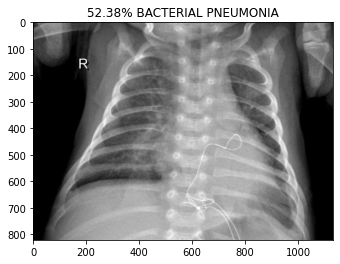

prob:[0.9641484  0.03585154]
BACTERIA/person809_bacteria_2717.jpeg


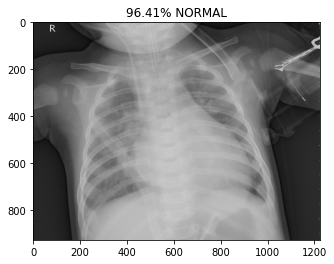

prob:[0.09827887 0.9017211 ]
BACTERIA/person809_bacteria_2718.jpeg


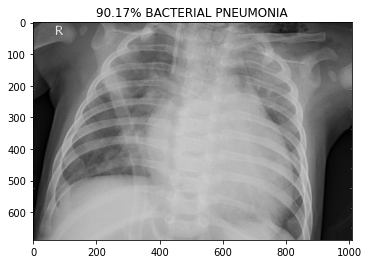

prob:[0.14604846 0.8539516 ]
BACTERIA/person810_bacteria_2719.jpeg


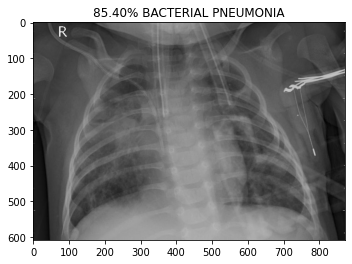

prob:[0.9647817  0.03521835]
BACTERIA/person811_bacteria_2721.jpeg


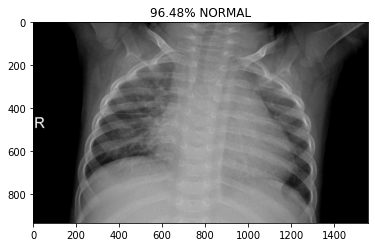

prob:[0.9845531  0.01544693]
BACTERIA/person813_bacteria_2723.jpeg


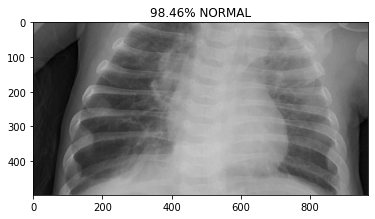

prob:[0.98658955 0.01341038]
BACTERIA/person813_bacteria_2724.jpeg


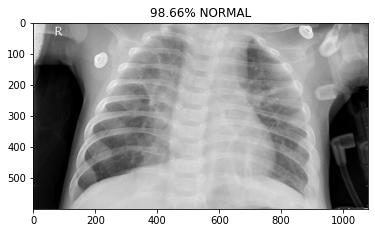

prob:[0.982137   0.01786301]
BACTERIA/person814_bacteria_2725.jpeg


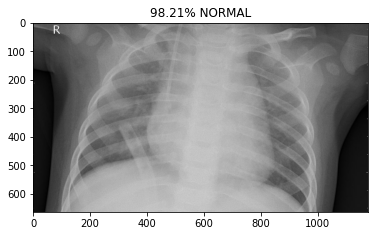

prob:[0.98923945 0.01076059]
BACTERIA/person815_bacteria_2726.jpeg


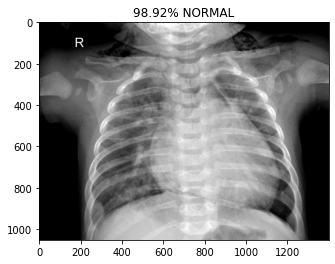

prob:[0.9852047  0.01479535]
BACTERIA/person816_bacteria_2727.jpeg


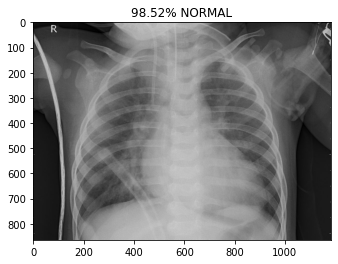

prob:[0.99143606 0.00856392]
BACTERIA/person817_bacteria_2728.jpeg


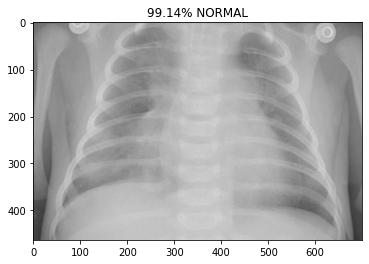

prob:[0.98050416 0.01949591]
BACTERIA/person818_bacteria_2729.jpeg


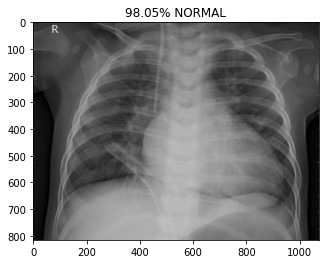

prob:[0.9915598  0.00844023]
BACTERIA/person819_bacteria_2730.jpeg


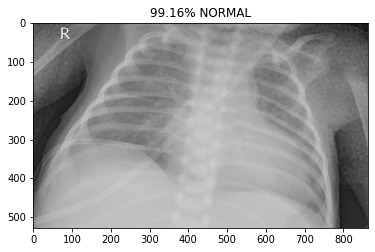

prob:[0.0552839  0.94471616]
BACTERIA/person820_bacteria_2731.jpeg


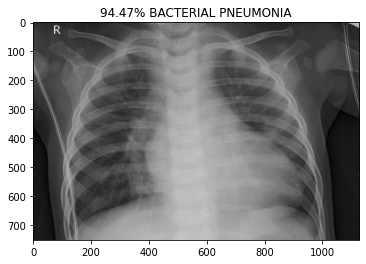

prob:[0.16414766 0.8358523 ]
BACTERIA/person825_bacteria_2736.jpeg


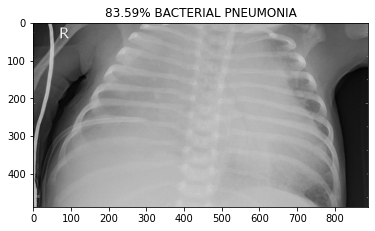

prob:[0.06158128 0.93841875]
BACTERIA/person826_bacteria_2737.jpeg


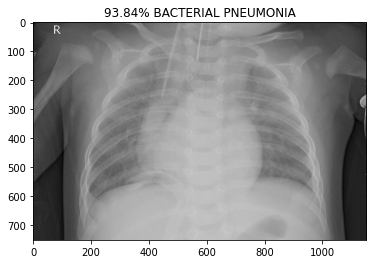

prob:[0.07706332 0.9229366 ]
BACTERIA/person827_bacteria_2738.jpeg


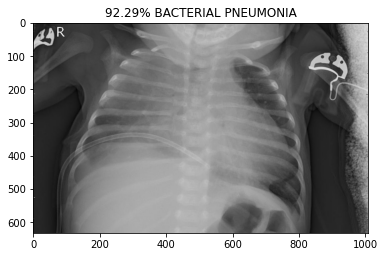

prob:[0.97528195 0.02471805]
BACTERIA/person829_bacteria_2740.jpeg


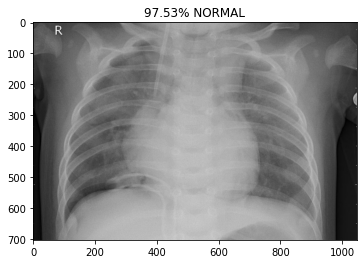

prob:[0.13712227 0.8628777 ]
BACTERIA/person830_bacteria_2741.jpeg


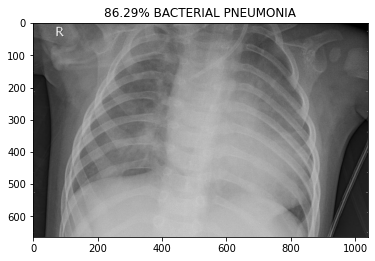

prob:[0.98780024 0.01219981]
BACTERIA/person831_bacteria_2742.jpeg


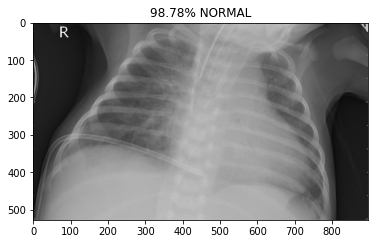

prob:[0.95996463 0.04003537]
BACTERIA/person832_bacteria_2743.jpeg


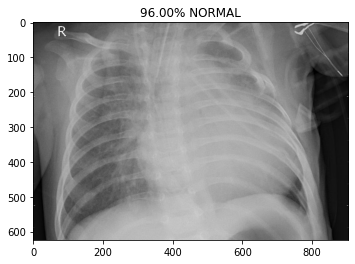

prob:[0.9893945  0.01060554]
BACTERIA/person834_bacteria_2747.jpeg


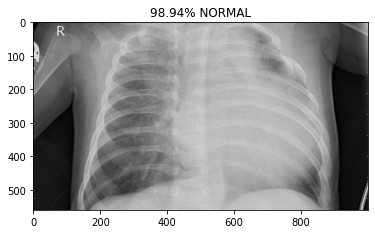

prob:[0.9759922  0.02400786]
BACTERIA/person834_bacteria_2748.jpeg


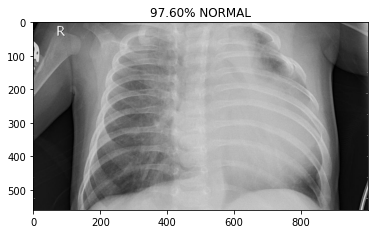

prob:[0.9709396  0.02906047]
BACTERIA/person835_bacteria_2749.jpeg


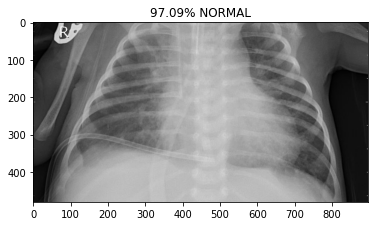

prob:[0.18438184 0.81561816]
BACTERIA/person835_bacteria_2750.jpeg


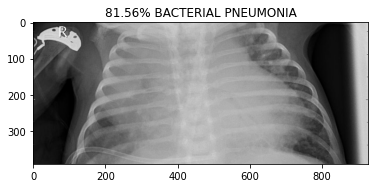

prob:[0.04374718 0.95625275]
BACTERIA/person836_bacteria_2752.jpeg


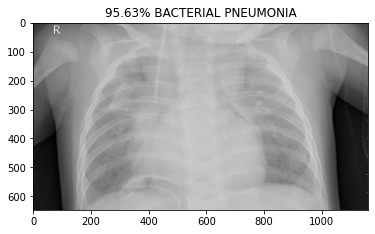

prob:[0.17203605 0.82796395]
BACTERIA/person837_bacteria_2753.jpeg


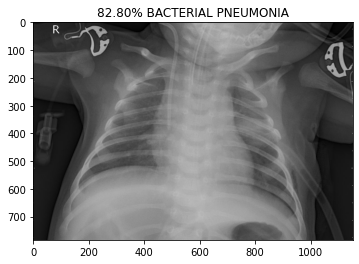

prob:[0.29773232 0.7022677 ]
BACTERIA/person837_bacteria_2754.jpeg


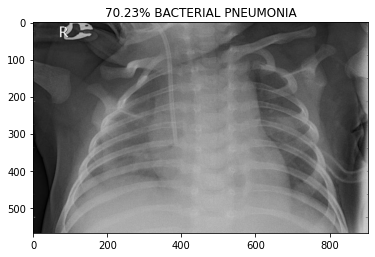

prob:[0.19370027 0.8062997 ]
BACTERIA/person839_bacteria_2757.jpeg


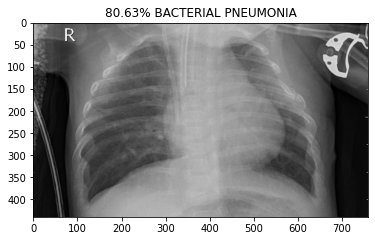

prob:[0.09262534 0.9073747 ]
BACTERIA/person840_bacteria_2758.jpeg


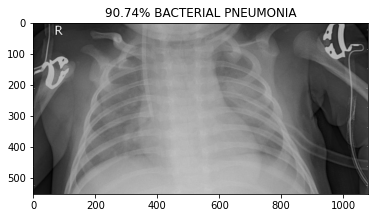

prob:[0.97463495 0.02536508]
BACTERIA/person840_bacteria_2759.jpeg


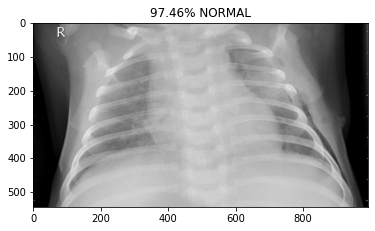

prob:[0.26284537 0.73715466]
BACTERIA/person841_bacteria_2760.jpeg


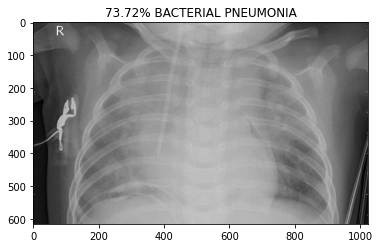

prob:[0.10529429 0.8947057 ]
BACTERIA/person841_bacteria_2761.jpeg


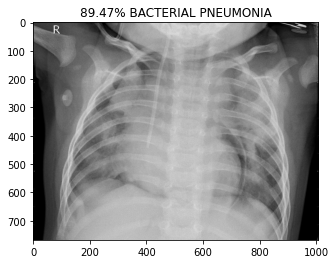

prob:[0.03148966 0.9685103 ]
BACTERIA/person842_bacteria_2762.jpeg


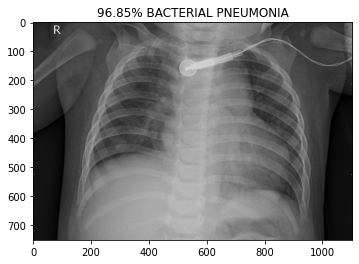

prob:[0.22350627 0.7764937 ]
BACTERIA/person843_bacteria_2763.jpeg


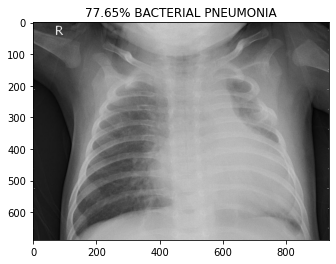

prob:[0.08378804 0.916212  ]
BACTERIA/person846_bacteria_2766.jpeg


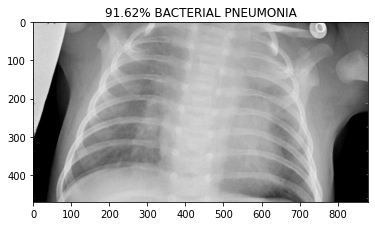

prob:[0.0978738 0.9021262]
BACTERIA/person847_bacteria_2767.jpeg


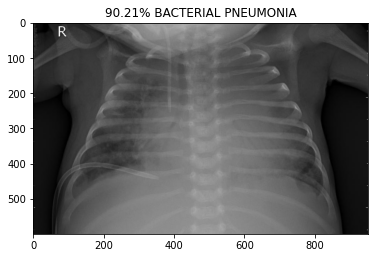

prob:[0.9810143  0.01898574]
BACTERIA/person848_bacteria_2769.jpeg


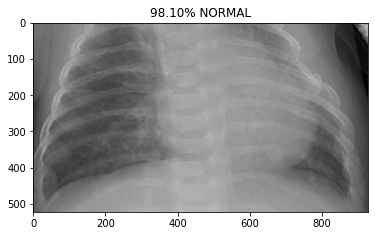

prob:[0.9417087  0.05829129]
BACTERIA/person849_bacteria_2770.jpeg


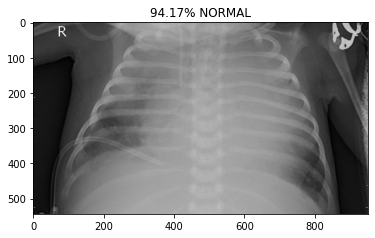

prob:[0.96650165 0.03349831]
BACTERIA/person850_bacteria_2771.jpeg


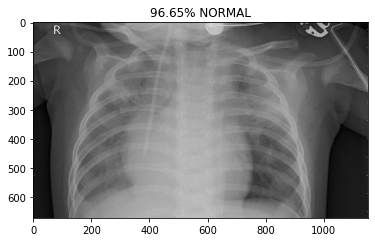

prob:[0.97262585 0.0273742 ]
BACTERIA/person853_bacteria_2774.jpeg


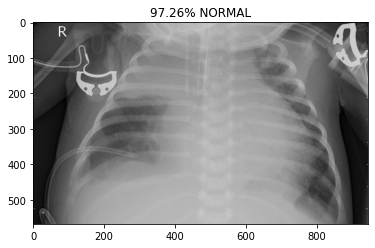

prob:[0.07880238 0.92119765]
BACTERIA/person853_bacteria_2775.jpeg


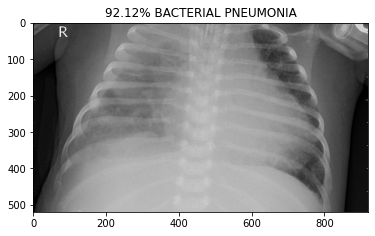

prob:[0.2749725  0.72502756]
BACTERIA/person854_bacteria_2776.jpeg


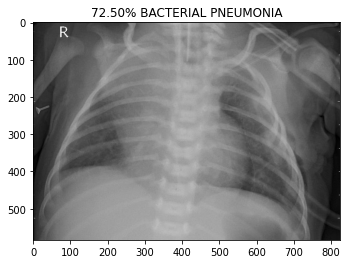

prob:[0.9688172  0.03118284]
BACTERIA/person855_bacteria_2777.jpeg


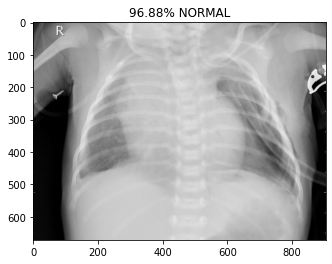

prob:[0.02960098 0.9703991 ]
BACTERIA/person858_bacteria_2780.jpeg


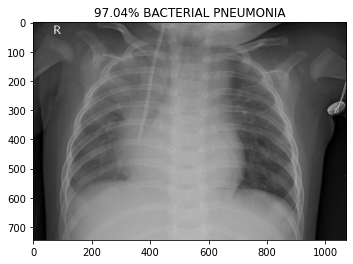

prob:[0.0686456  0.93135434]
BACTERIA/person862_bacteria_2784.jpeg


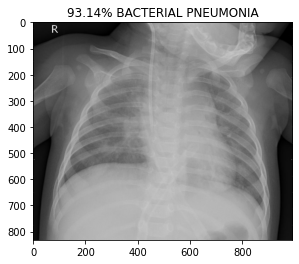

prob:[0.15576734 0.8442327 ]
BACTERIA/person863_bacteria_2785.jpeg


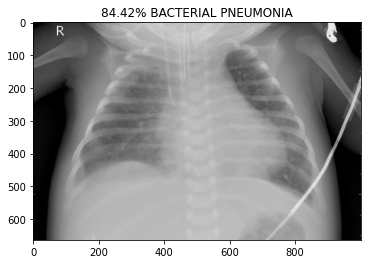

prob:[0.0512604 0.9487395]
BACTERIA/person866_bacteria_2788.jpeg


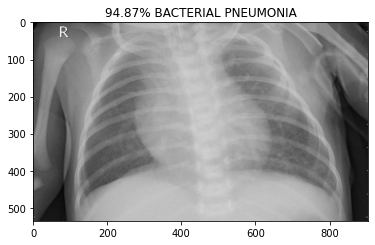

prob:[0.26441246 0.73558754]
BACTERIA/person867_bacteria_2789.jpeg


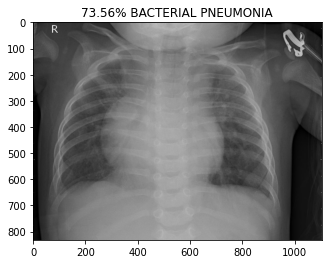

prob:[0.09115255 0.9088474 ]
BACTERIA/person870_bacteria_2792.jpeg


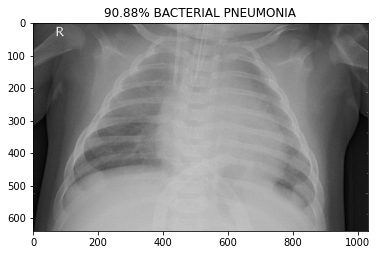

prob:[0.9693284 0.0306716]
BACTERIA/person871_bacteria_2793.jpeg


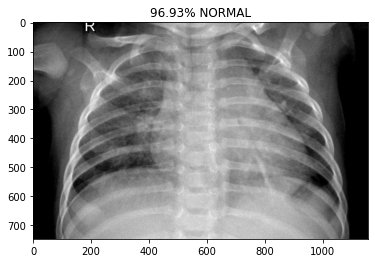

prob:[0.03552871 0.96447134]
BACTERIA/person872_bacteria_2795.jpeg


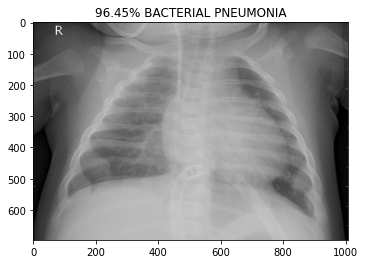

prob:[0.11706783 0.8829322 ]
BACTERIA/person873_bacteria_2796.jpeg


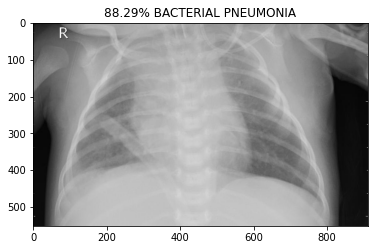

prob:[0.9928088  0.00719118]
BACTERIA/person874_bacteria_2797.jpeg


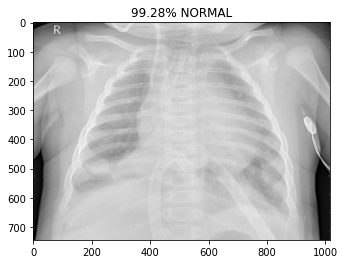

prob:[0.94588494 0.05411508]
BACTERIA/person875_bacteria_2798.jpeg


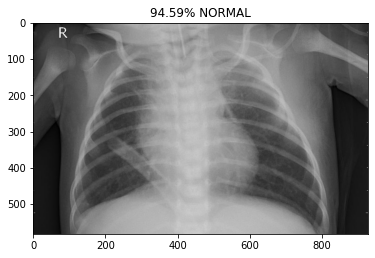

prob:[0.9089499  0.09105007]
BACTERIA/person876_bacteria_2799.jpeg


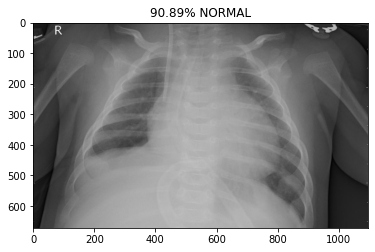

prob:[0.24690987 0.75309014]
BACTERIA/person877_bacteria_2800.jpeg


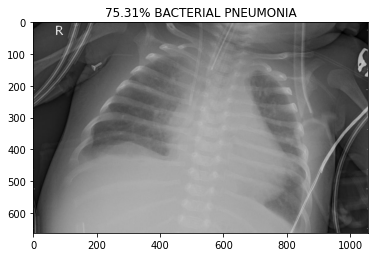

prob:[0.9045043 0.0954957]
BACTERIA/person878_bacteria_2801.jpeg


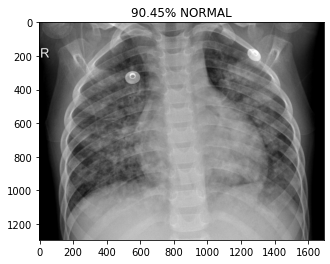

prob:[0.9726031  0.02739688]
BACTERIA/person880_bacteria_2804.jpeg


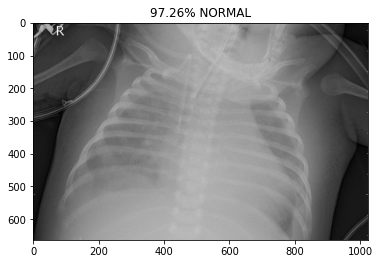

prob:[0.13068283 0.8693172 ]
BACTERIA/person881_bacteria_2805.jpeg


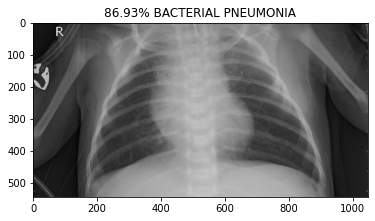

prob:[0.9905571  0.00944297]
BACTERIA/person882_bacteria_2806.jpeg


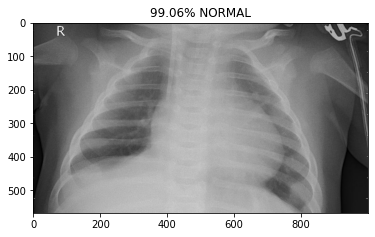

prob:[0.04999526 0.9500047 ]
BACTERIA/person883_bacteria_2807.jpeg


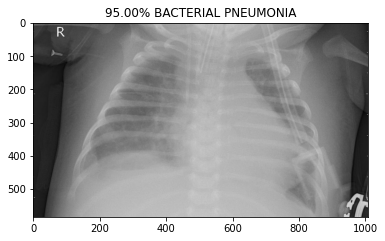

prob:[0.09783116 0.90216887]
BACTERIA/person884_bacteria_2808.jpeg


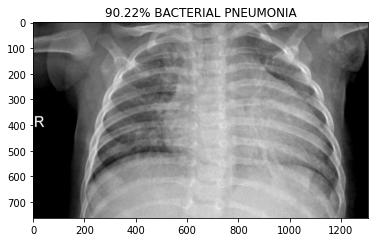

prob:[0.18610553 0.81389445]
BACTERIA/person885_bacteria_2809.jpeg


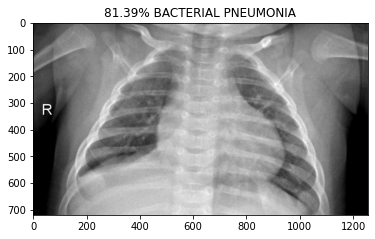

prob:[0.98807484 0.01192522]
BACTERIA/person886_bacteria_2810.jpeg


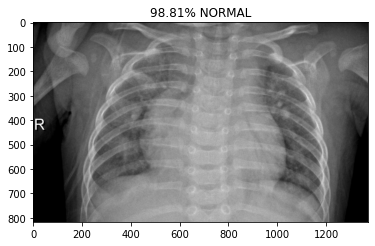

prob:[0.37640333 0.6235967 ]
BACTERIA/person887_bacteria_2811.jpeg


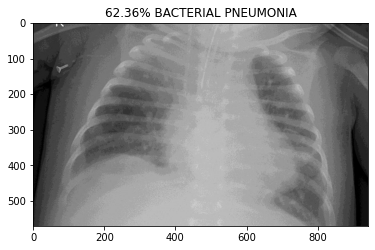

prob:[0.08187868 0.9181213 ]
BACTERIA/person888_bacteria_2812.jpeg


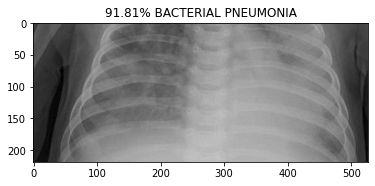

prob:[0.0534402 0.9465598]
BACTERIA/person889_bacteria_2813.jpeg


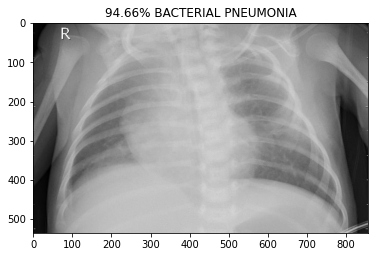

prob:[0.06837263 0.9316274 ]
BACTERIA/person890_bacteria_2814.jpeg


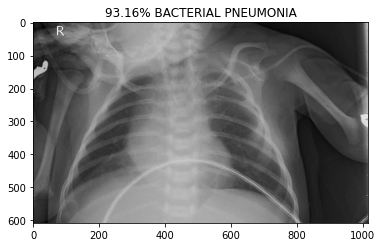

prob:[0.09975881 0.90024126]
BACTERIA/person892_bacteria_2817.jpeg


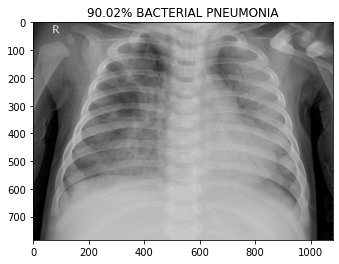

prob:[0.97175455 0.02824548]
BACTERIA/person893_bacteria_2818.jpeg


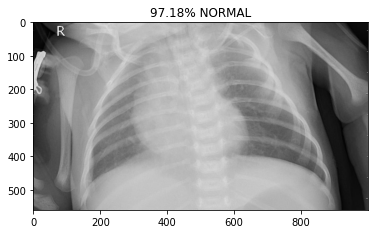

prob:[0.9941397 0.0058604]
BACTERIA/person894_bacteria_2819.jpeg


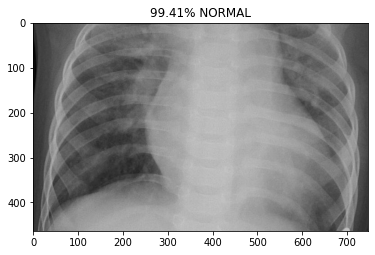

prob:[0.9767661  0.02323392]
BACTERIA/person895_bacteria_2820.jpeg


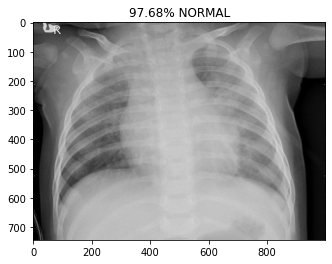

prob:[0.9412037  0.05879629]
BACTERIA/person896_bacteria_2821.jpeg


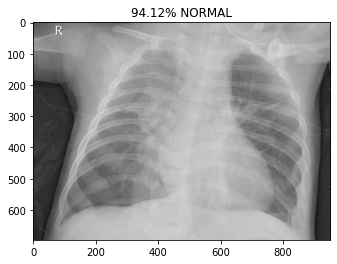

prob:[0.9742482  0.02575183]
BACTERIA/person897_bacteria_2822.jpeg


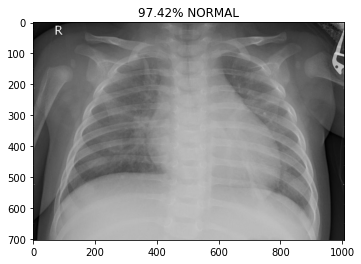

prob:[0.9796983 0.0203017]
BACTERIA/person898_bacteria_2823.jpeg


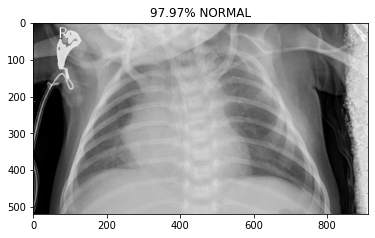

prob:[0.9258104 0.0741896]
BACTERIA/person902_bacteria_2827.jpeg


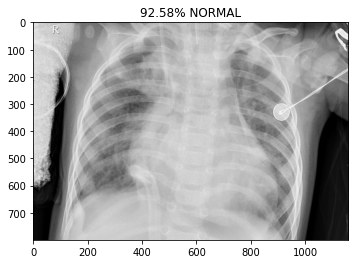

prob:[0.26592603 0.73407394]
BACTERIA/person903_bacteria_2828.jpeg


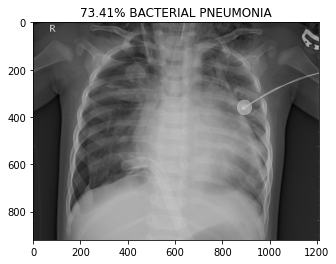

prob:[0.5419445 0.4580555]
BACTERIA/person904_bacteria_2829.jpeg


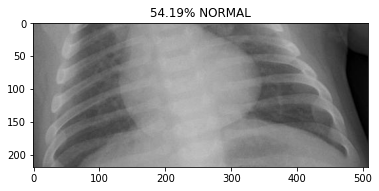

prob:[0.9401312  0.05986879]
BACTERIA/person905_bacteria_2830.jpeg


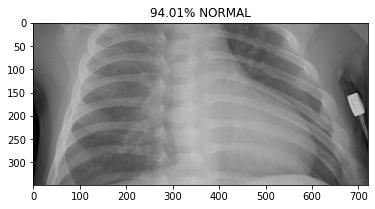

prob:[0.95438737 0.04561263]
BACTERIA/person906_bacteria_2831.jpeg


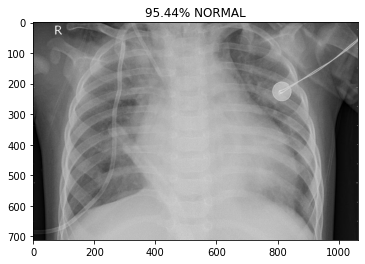

prob:[0.30060235 0.6993976 ]
BACTERIA/person907_bacteria_2832.jpeg


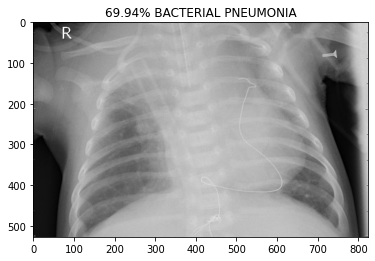

prob:[0.08774173 0.91225827]
BACTERIA/person909_bacteria_2834.jpeg


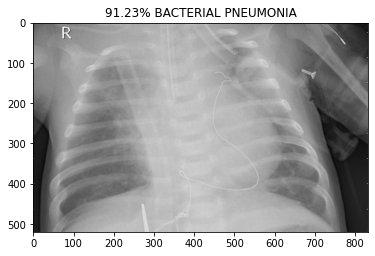

prob:[0.04551701 0.954483  ]
BACTERIA/person911_bacteria_2836.jpeg


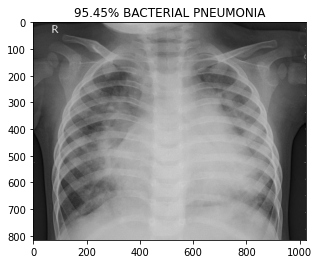

prob:[0.98587924 0.0141208 ]
BACTERIA/person912_bacteria_2837.jpeg


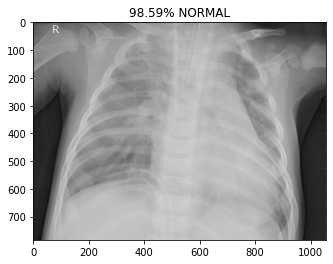

prob:[0.1464364 0.8535636]
BACTERIA/person913_bacteria_2838.jpeg


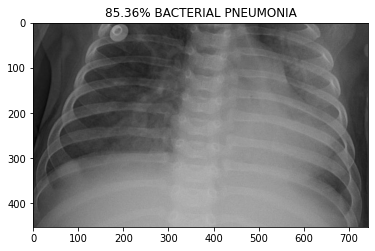

prob:[0.14485472 0.8551452 ]
BACTERIA/person914_bacteria_2839.jpeg


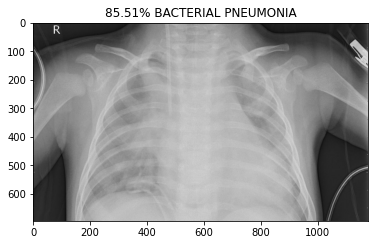

prob:[0.9756141  0.02438589]
BACTERIA/person916_bacteria_2841.jpeg


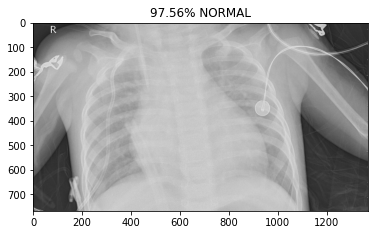

prob:[0.25375527 0.74624467]
BACTERIA/person917_bacteria_2842.jpeg


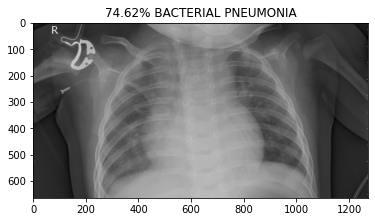

prob:[0.15841202 0.84158796]
BACTERIA/person918_bacteria_2843.jpeg


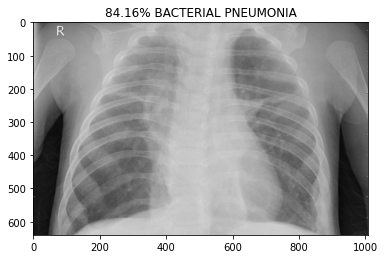

prob:[0.9806207  0.01937932]
BACTERIA/person919_bacteria_2844.jpeg


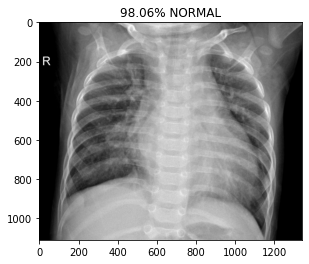

In [ ]:
pred = model.predict_generator(test_set,10,verbose=1)
print("Predictions finished")
import cv2
import matplotlib.image as mpimg
for index, probability in enumerate(pred):
 image_path = valid + "/" +test_set.filenames[index]
 image = mpimg.imread(image_path)
 image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
 pixels = np.array(image)
 plt.imshow(pixels)
 print("prob:{}".format(probability))
 print(test_set.filenames[index])
 if probability[1] > 0.5:
     plt.title('%.2f' % (probability[1]*100) + '% BACTERIAL PNEUMONIA')
 else:
     plt.title('%.2f' % ((1-probability[1])*100) + '% NORMAL')
 plt.show()